# Installation and Importing



In [ ]:
!pip install retina-face
!git clone https://github.com/emilianavt/OpenSeeFace.git
!pip install onnxruntime opencv-python pillow numpy ort-nightly

ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

tensorflow 2.10.0 requires numpy>=1.20, but you'll have numpy 1.19.2 which is incompatible.



  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
    Preparing wheel metadata: started
    Preparing wheel metadata: finished with status 'done'
  Using cached Keras_Preprocessing-1.1.2-py2.py3-none-any.whl (42 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl (57 kB)
  Using cached opt_einsum-3.3.0-py3-none-any.whl (65 kB)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl (12 kB)
  Using cached tensorboard_data_server-0.6.1-py3-none-any.whl (2.4 kB)
  Using cached google_auth_oauthlib-0.4.6-py2.py3-none-any.whl (18 kB)
  Using cached pyasn1_modules-0.2.8-py2.py3-none-any.whl (155 kB)
  Using cached pyasn1-0.4.8-py2.py3-none-any.whl (77 kB)
  Created wheel for gdown: filename=gdown-4.5.3-py3-none-any.whl size=14821 sha256=3fd724ed82186bbe258eeb9cd60ddd11d0e19b67

'git' is not recognized as an internal or external command,
operable program or batch file.


ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

onnxruntime 1.13.1 requires numpy>=1.21.6, but you'll have numpy 1.19.2 which is incompatible.
ort-nightly 1.11.0.dev20220320001 requires numpy>=1.22.3, but you'll have numpy 1.19.2 which is incompatible.



  Using cached coloredlogs-15.0.1-py2.py3-none-any.whl (46 kB)
  Using cached humanfriendly-10.0-py2.py3-none-any.whl (86 kB)
  Using cached pyreadline3-3.4.1-py3-none-any.whl (95 kB)


In [ ]:
import cv2
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
from retinaface import RetinaFace
# from google.colab.patches import cv2_imshow

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

ImportError: initialization failed

# Get testset from Google Drive
Types:
* Normal: 1 to 11
* Noisy: 12 to 20
* Blurry: 21 to 30
* Different angles: 31 to 40

In [4]:
!gdown 1zzH-YnW7A-L0NQBhZIgOxq-0vsrk7_-2
!unzip TestsetForFaceDetection.zip -d testset

Downloading...
From: https://drive.google.com/uc?id=1zzH-YnW7A-L0NQBhZIgOxq-0vsrk7_-2
To: /content/TestsetForFaceDetection.zip
100% 75.1M/75.1M [00:00<00:00, 105MB/s]
Archive:  TestsetForFaceDetection.zip
  inflating: testset/29.png          
  inflating: testset/30.jpg          
  inflating: testset/31.jpg          
  inflating: testset/32.jpg          
  inflating: testset/33.jpg          
  inflating: testset/34.jpg          
  inflating: testset/35.jpg          
  inflating: testset/36.jpg          
  inflating: testset/37.jpg          
  inflating: testset/38.jpg          
  inflating: testset/39.jpg          
  inflating: testset/40.jpg          
  inflating: testset/clip_1.avi      
  inflating: testset/clip_1.mp4      
  inflating: testset/1.jpg           
  inflating: testset/2.jpg           
  inflating: testset/3.jpg           
  inflating: testset/4.png           
  inflating: testset/5.jpg           
  inflating: testset/6.jpg           
  inflating: testset/7.jpg         

# RetinaFace

In [ ]:
# Explore package
dir(RetinaFace)

NameError: ignored

### Normal images

  0%|          | 0/11 [00:00<?, ?it/s]

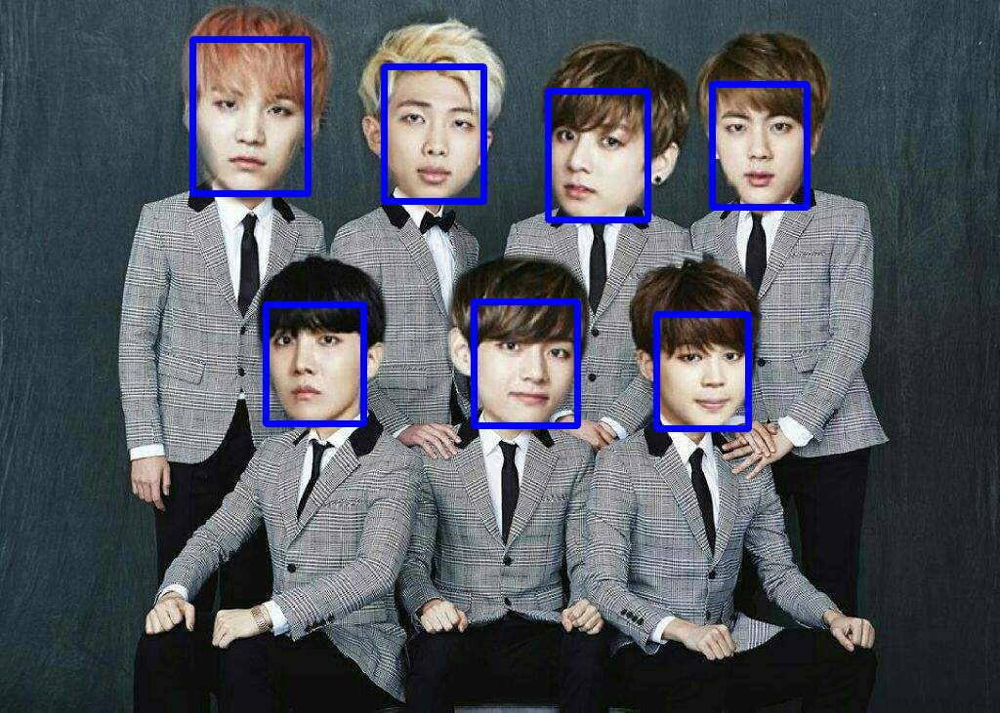

  9%|▉         | 1/11 [00:07<01:12,  7.23s/it]

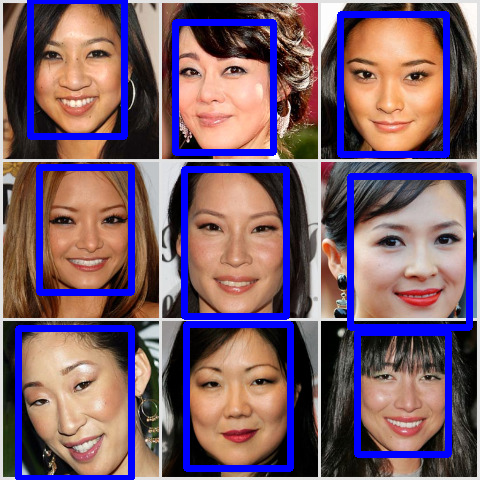

 18%|█▊        | 2/11 [00:12<00:54,  6.11s/it]

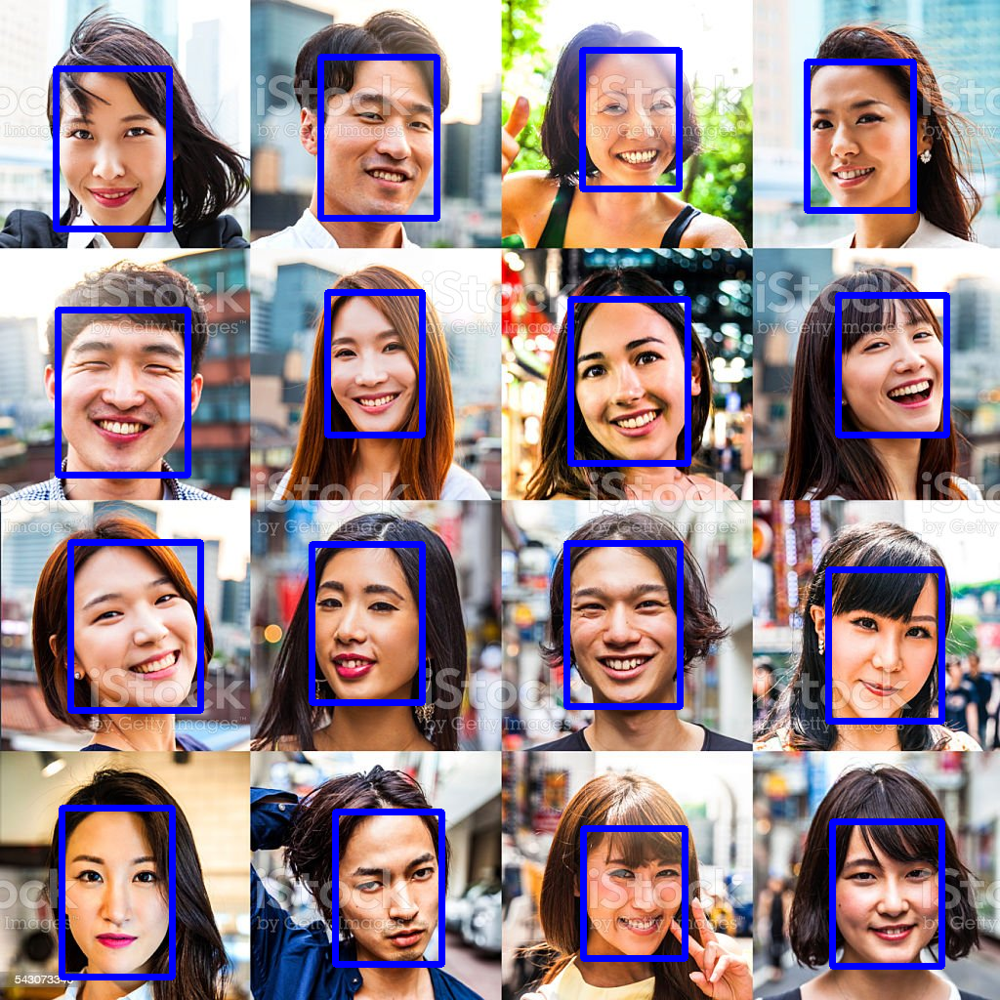

 27%|██▋       | 3/11 [00:18<00:46,  5.85s/it]

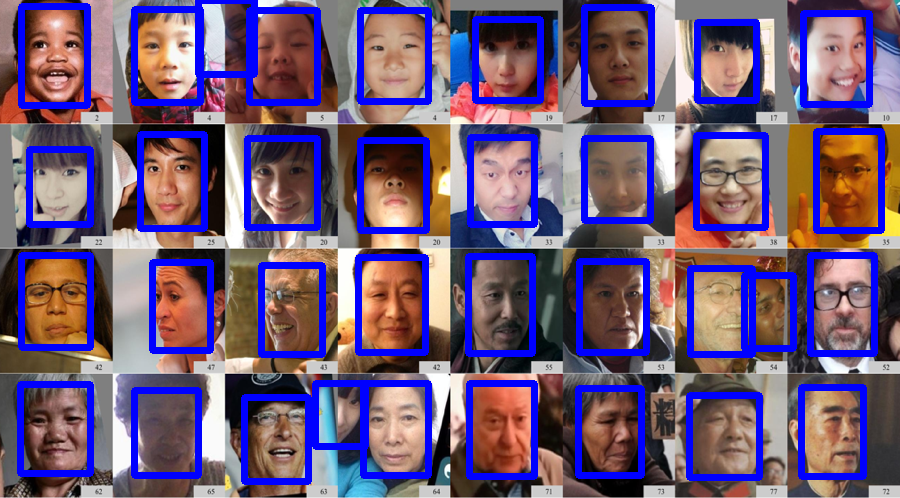

 36%|███▋      | 4/11 [00:27<00:51,  7.30s/it]

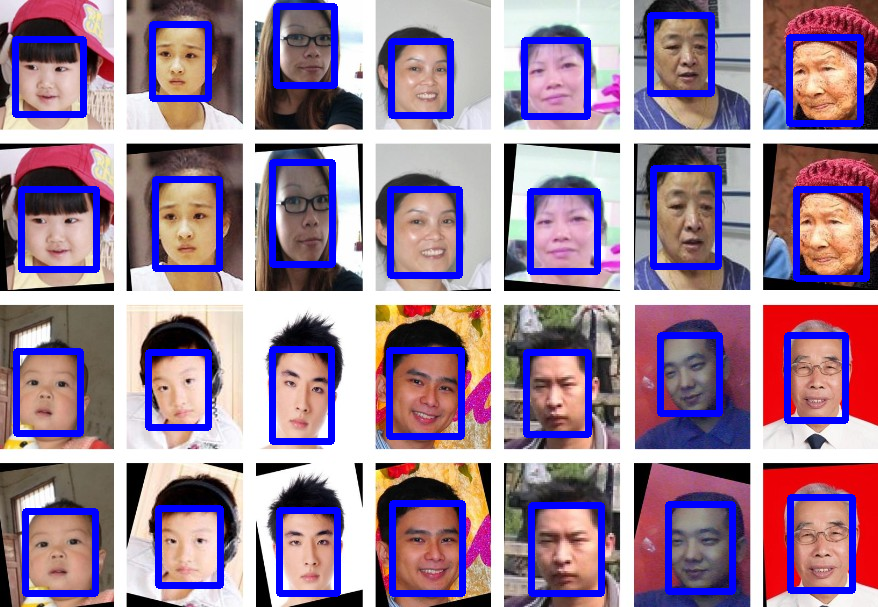

 45%|████▌     | 5/11 [00:35<00:44,  7.44s/it]

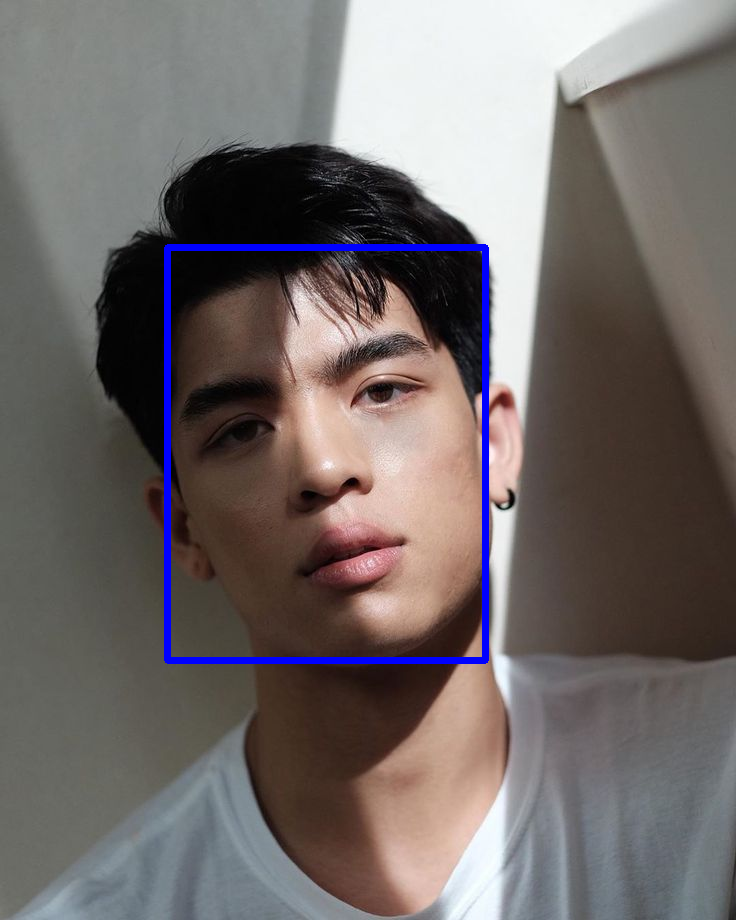

 55%|█████▍    | 6/11 [00:44<00:40,  8.12s/it]

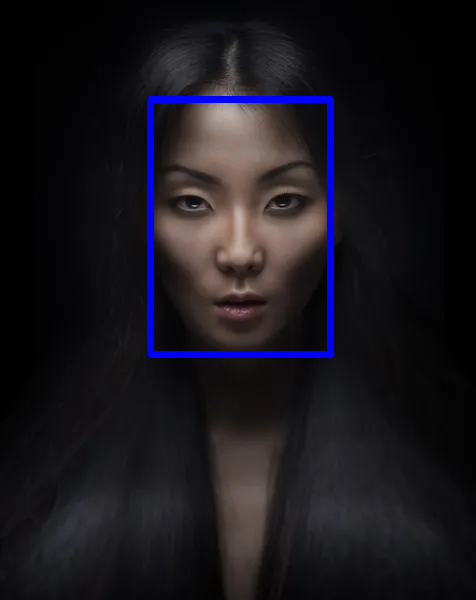

 64%|██████▎   | 7/11 [00:51<00:30,  7.60s/it]

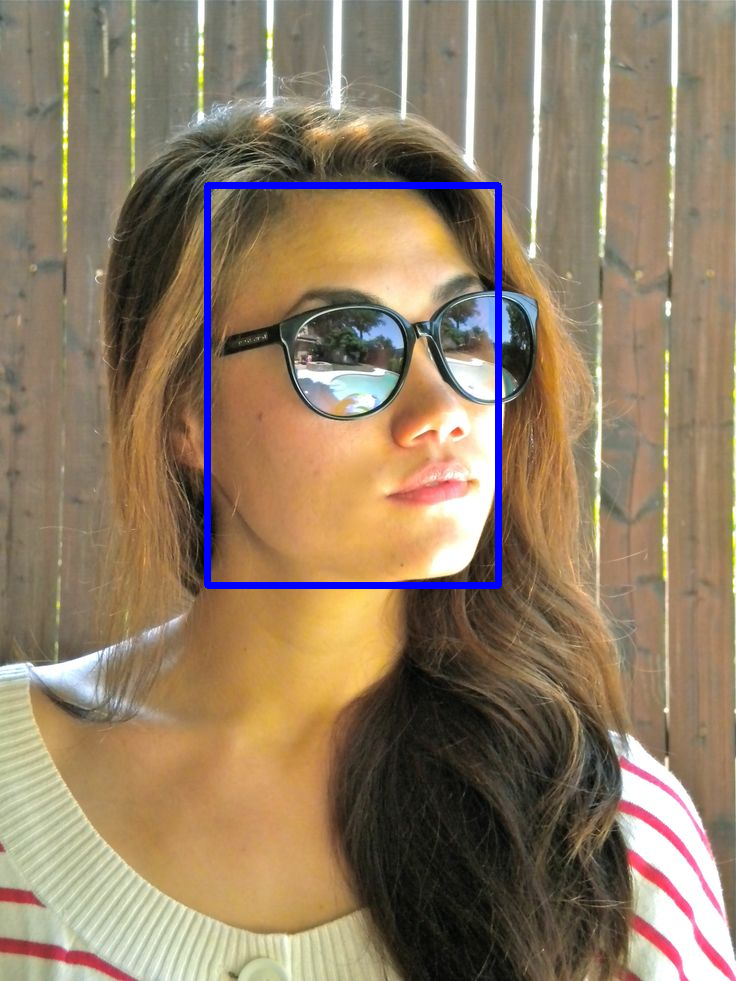

 73%|███████▎  | 8/11 [00:58<00:22,  7.42s/it]

No face detected in testset/9.jpg


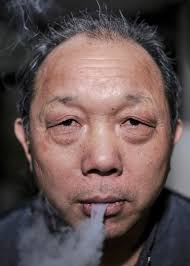

 82%|████████▏ | 9/11 [01:05<00:14,  7.33s/it]

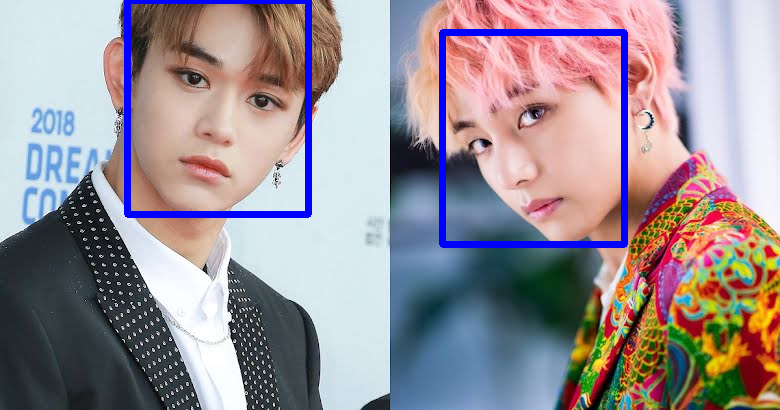

 91%|█████████ | 10/11 [01:14<00:07,  7.98s/it]

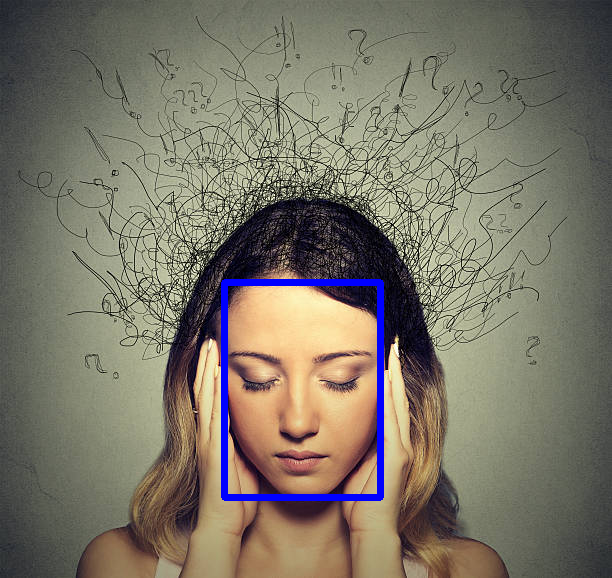

100%|██████████| 11/11 [01:20<00:00,  7.32s/it]

Acc: 10/20


In [ ]:
test_size = 11  # Number of pictures in testset
detectable = 0  # Number of pictures having detected faces
for i in tqdm(range(1, 12)):
    path = 'testset/'
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img_path)
    # Draw faces' bounding box on image 
    img = cv2.imread(img_path)
    try:
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]
        for box in boxes:
            img = cv2.rectangle(img, box[:2], box[2:], color=(255,0,0), thickness=5)
        detectable += 1
    except:
        print('No face detected in ' + img_path)
        pass
    cv2_imshow(img)
print(f'\nAcc: {detectable}/{test_size}')

### Noisy Images

  0%|          | 0/9 [00:00<?, ?it/s]

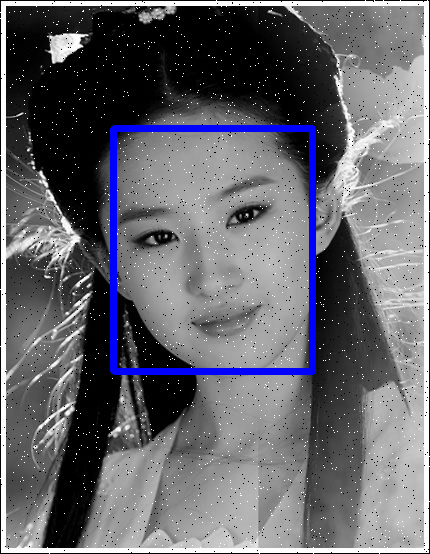

 11%|█         | 1/9 [00:06<00:54,  6.82s/it]

No face detected in testset/13.png


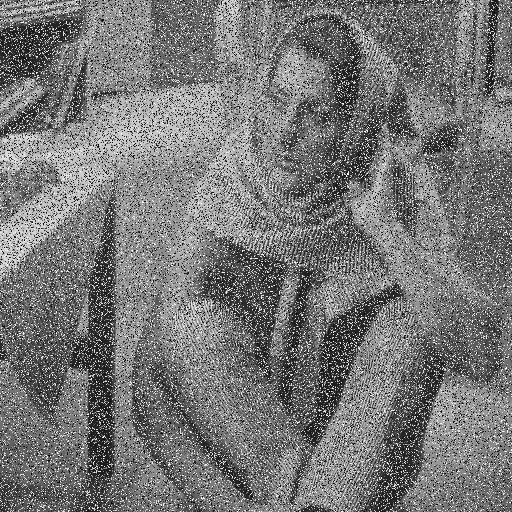

 22%|██▏       | 2/9 [00:12<00:41,  5.99s/it]

No face detected in testset/14.png


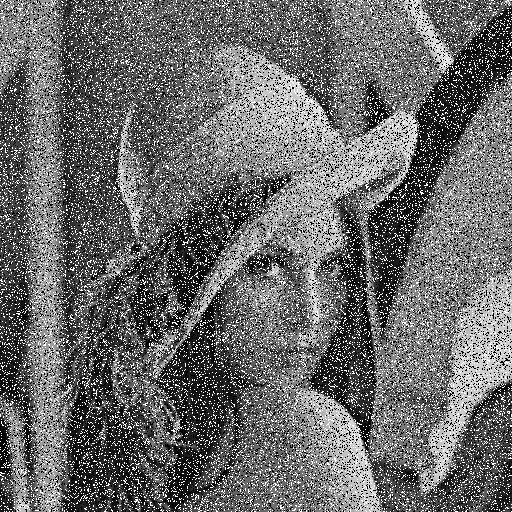

 33%|███▎      | 3/9 [00:18<00:36,  6.16s/it]

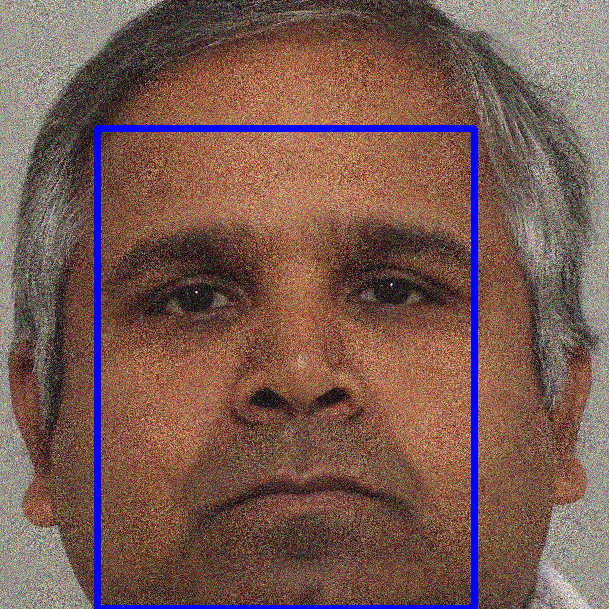

 44%|████▍     | 4/9 [00:23<00:28,  5.74s/it]

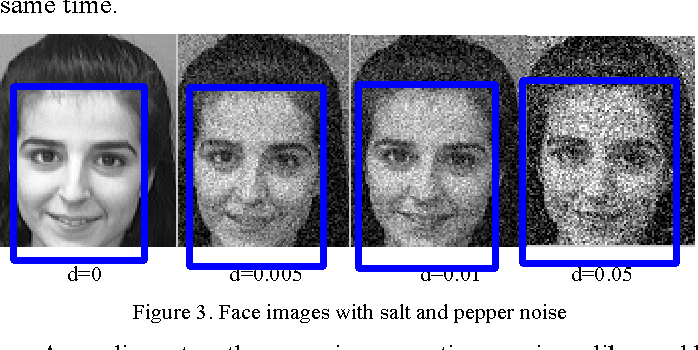

 56%|█████▌    | 5/9 [00:33<00:28,  7.06s/it]

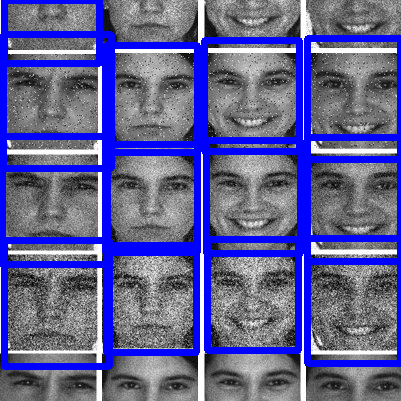

 67%|██████▋   | 6/9 [00:39<00:20,  6.86s/it]

No face detected in testset/18.png


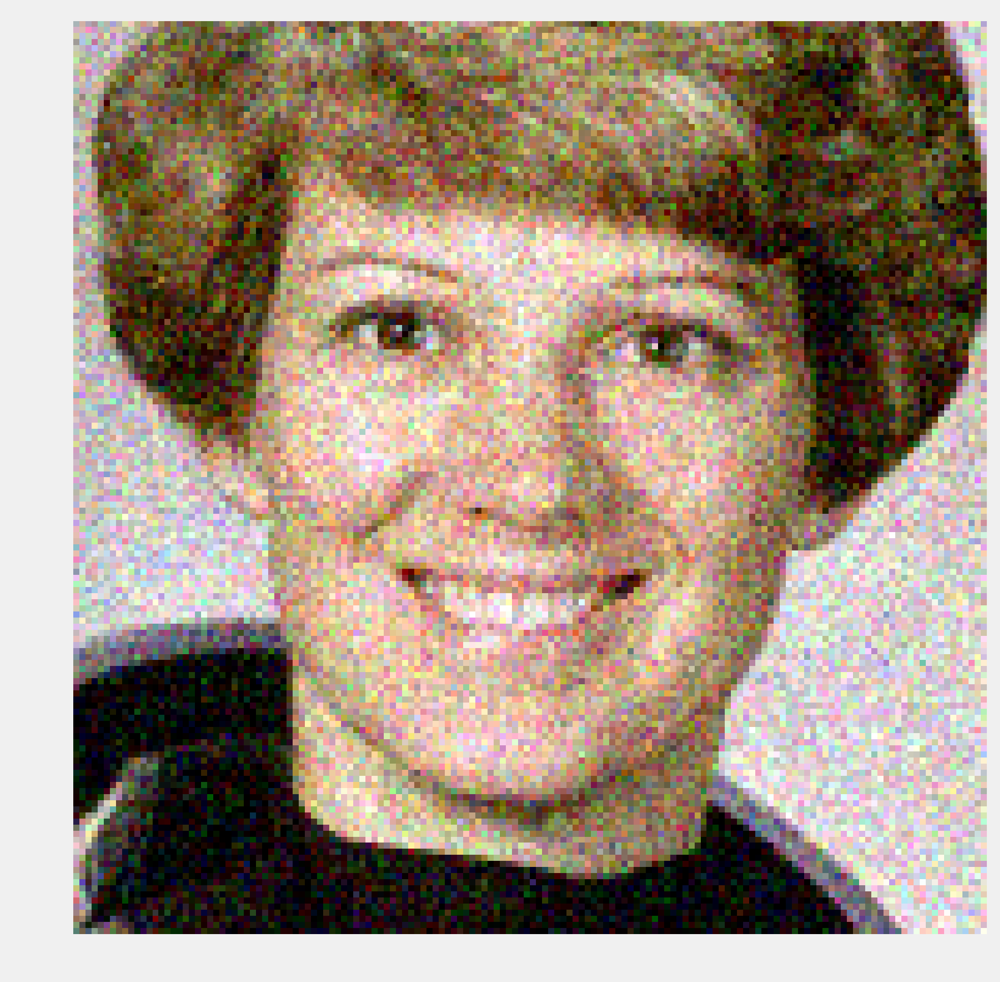

 78%|███████▊  | 7/9 [00:45<00:12,  6.40s/it]

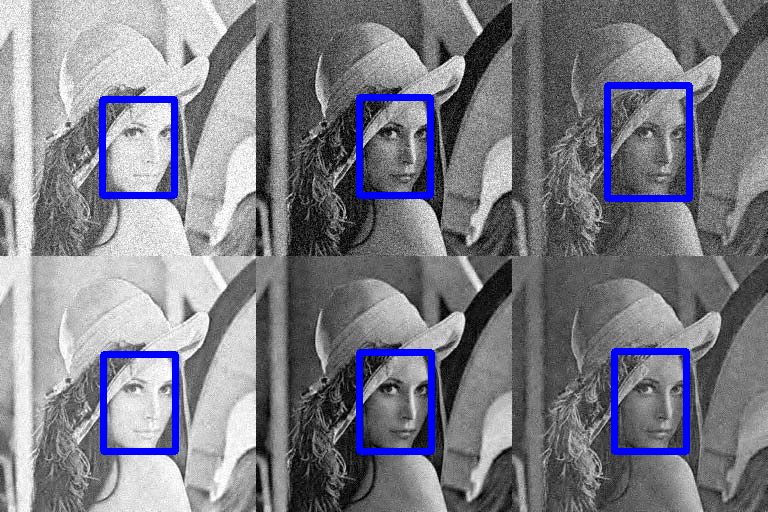

 89%|████████▉ | 8/9 [00:52<00:06,  6.76s/it]

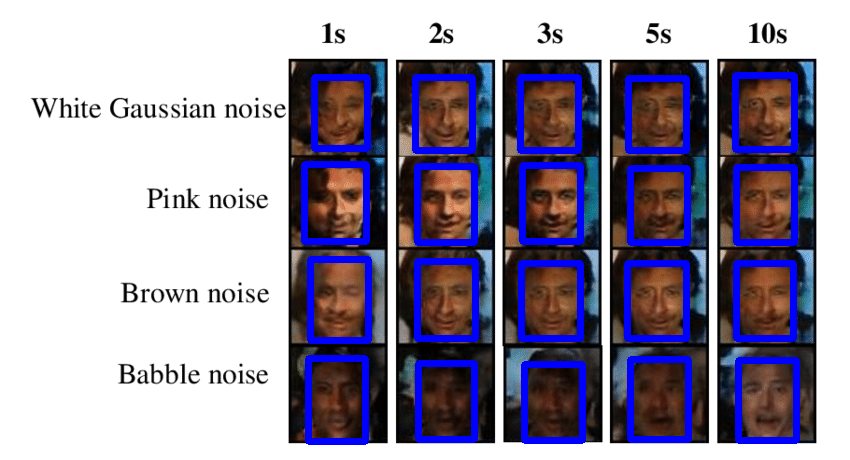

100%|██████████| 9/9 [01:01<00:00,  6.86s/it]

Acc: 6/20


In [ ]:
test_size = 9  # Number of pictures in testset
detectable = 0  # Number of pictures having detected faces
path = 'testset/'
for i in tqdm(range(12, 21)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img_path)
    # Draw faces' bounding box on image 
    img = cv2.imread(img_path)
    try:
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]
        for box in boxes:
            img = cv2.rectangle(img, box[:2], box[2:], color=(255,0,0), thickness=5)
        detectable += 1
    except:
        print('No face detected in ' + img_path)
        pass
    cv2_imshow(img)
print(f'\nAcc: {detectable}/{test_size}')

(2129, 2091)
(200, 200)
No face detected in 18_resized.png


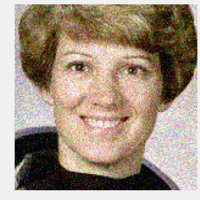

In [ ]:
# Resize image 18
path = 'testset/'
image = Image.open(path + '18.png')
new_image = image.resize((200, 200))
new_image.save(path + '18_resized.png')

print(image.size) # Output: (1920, 1280)
print(new_image.size) # Output: (200, 200)

# Detect faces
detected_faces = RetinaFace.detect_faces(path + '18_resized.png')
# Draw bounding boxes
img = cv2.imread(path + '18_resized.png')
try:
    boxes = [f[1]['Facial_area'] for f in detected_faces.items()]
    for box in boxes:
        img = cv2.rectangle(img, box[:2], box[2:], color=(0,0,255), thickness=5)
except:
    print('No face detected in 18_resized.png')
cv2_imshow(img)

### Blurry Images

  0%|          | 0/10 [00:00<?, ?it/s]

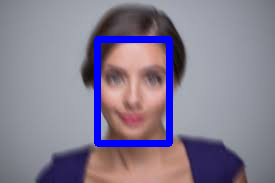

 10%|█         | 1/10 [00:09<01:21,  9.04s/it]

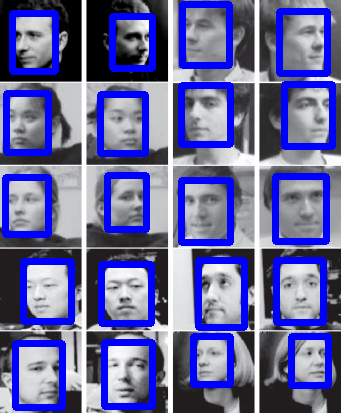

 20%|██        | 2/10 [00:15<00:58,  7.30s/it]

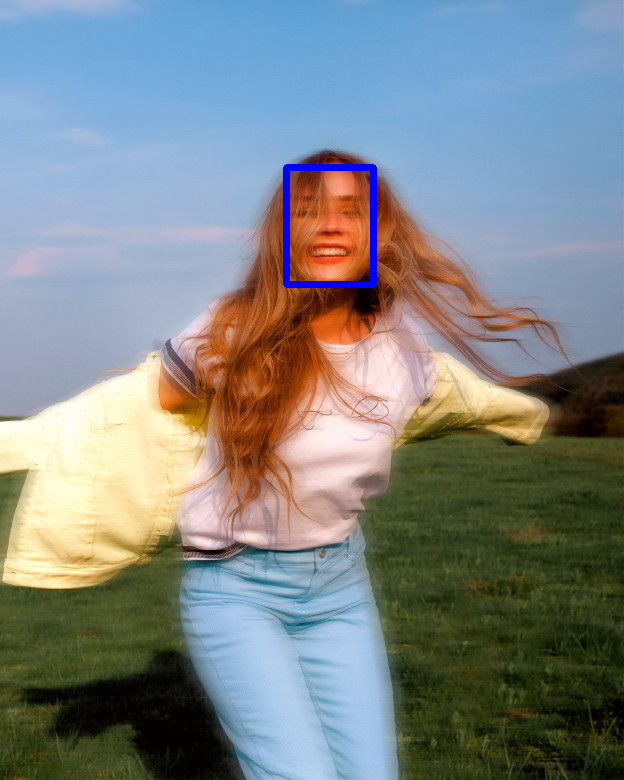

 30%|███       | 3/10 [00:21<00:48,  6.87s/it]

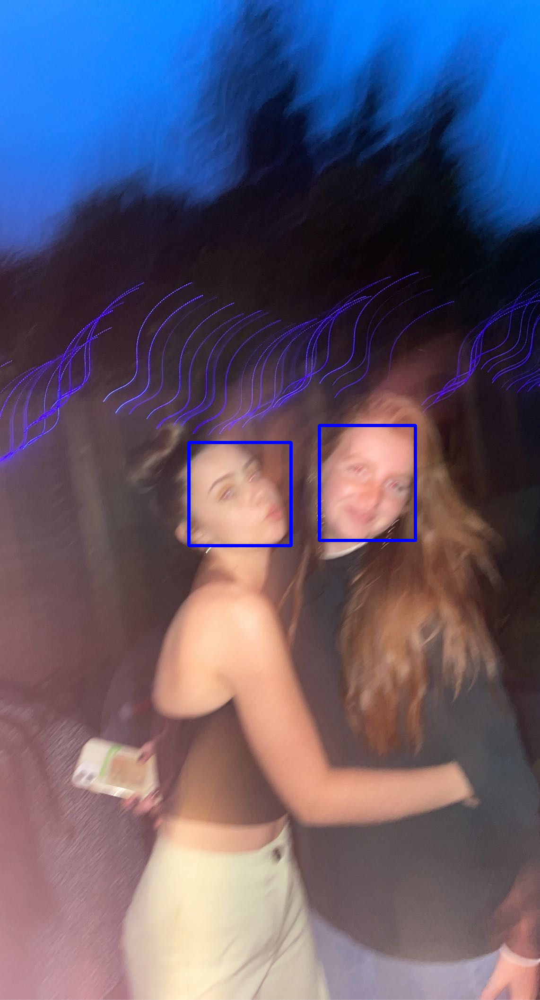

 40%|████      | 4/10 [00:31<00:48,  8.05s/it]

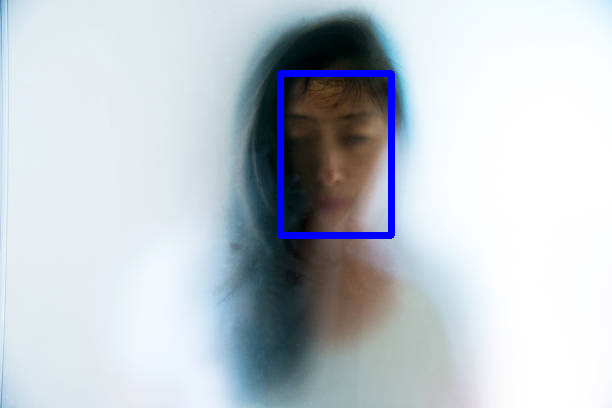

 50%|█████     | 5/10 [00:38<00:39,  7.90s/it]

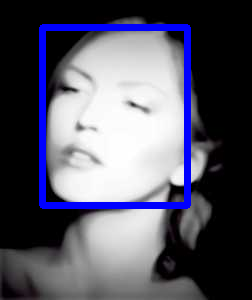

 60%|██████    | 6/10 [00:44<00:29,  7.26s/it]

No face detected in testset/27.jpg


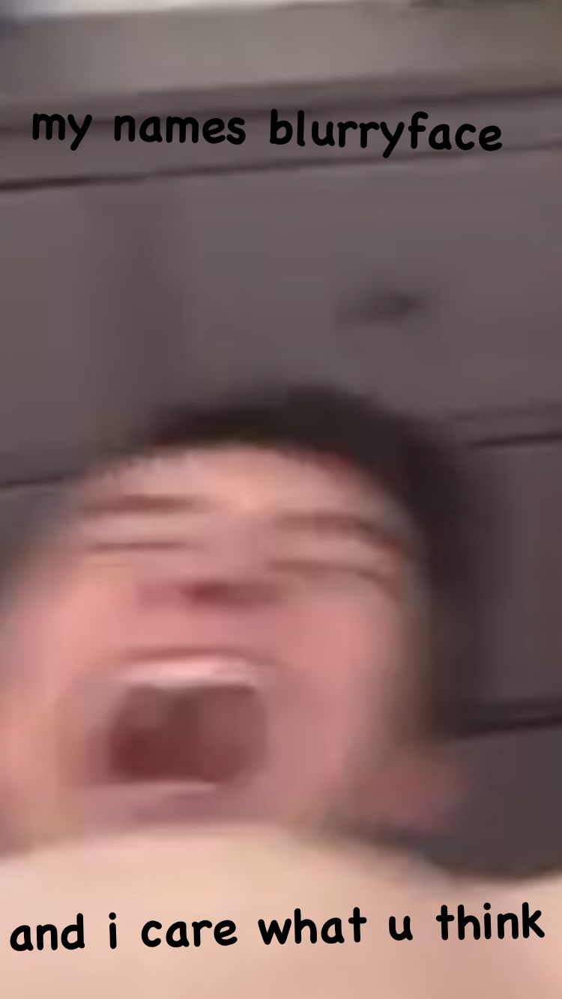

 70%|███████   | 7/10 [00:53<00:23,  7.79s/it]

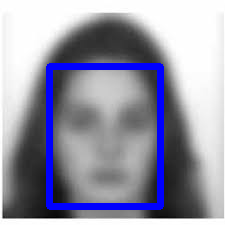

 80%|████████  | 8/10 [01:00<00:14,  7.36s/it]

No face detected in testset/29.png


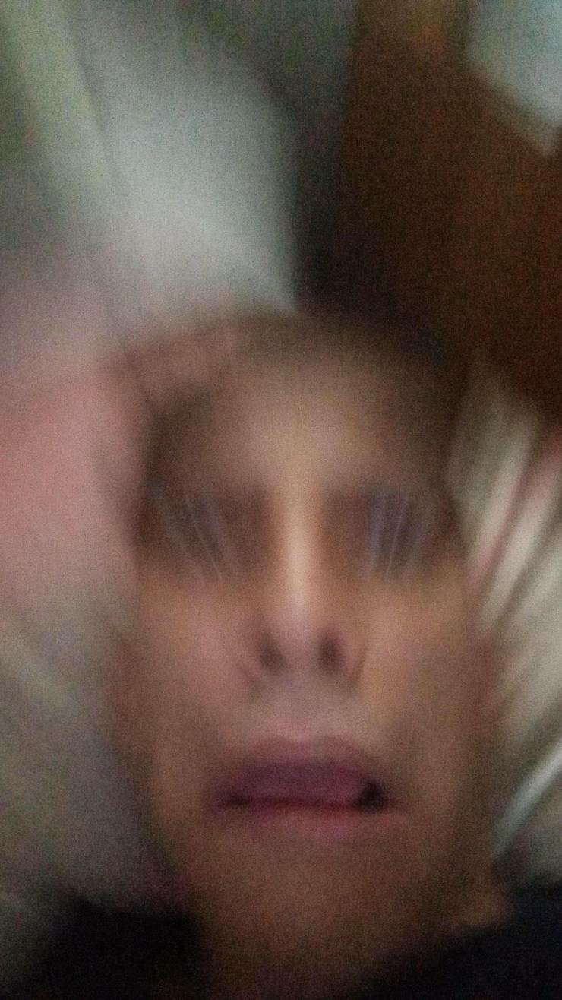

 90%|█████████ | 9/10 [01:09<00:07,  7.91s/it]

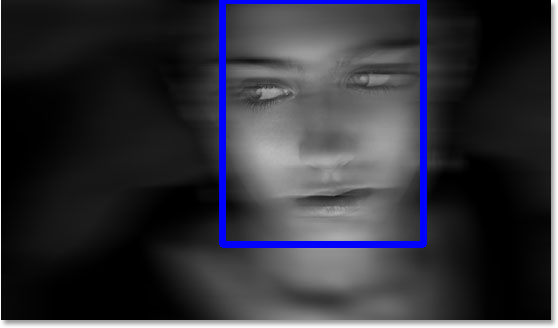

100%|██████████| 10/10 [01:18<00:00,  7.81s/it]

Acc: 8/20


In [ ]:
test_size = 10  # Number of pictures in testset
detectable = 0  # Number of pictures having detected faces
path = 'testset/'
for i in tqdm(range(21, 31)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img_path)
    # Draw faces' bounding box on image 
    img = cv2.imread(img_path)
    try:
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]
        for box in boxes:
            img = cv2.rectangle(img, box[:2], box[2:], color=(255,0,0), thickness=5)
        detectable += 1
    except:
        print('No face detected in ' + img_path)
    cv2_imshow(img)
print(f'\nAcc: {detectable}/{test_size}')

(750, 1334)
(200, 200)
No face detected in 27_resized.jpg


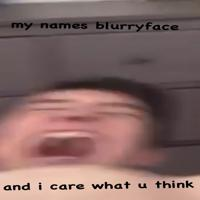

In [ ]:
# Resize image 27
path = 'testset/'
image = Image.open(path + '27.jpg')
new_image = image.resize((200, 200))
new_image.save(path + '27_resized.jpg')

print(image.size) # Output: (1920, 1280)
print(new_image.size) # Output: (200, 200)

# Detect faces
detected_faces = RetinaFace.detect_faces(path + '27_resized.jpg')
# Draw bounding boxes
img = cv2.imread(path + '27_resized.jpg')
try:
    boxes = [f[1]['Facial_area'] for f in detected_faces.items()]
    for box in boxes:
        img = cv2.rectangle(img, box[:2], box[2:], color=(0,0,255), thickness=5)
except:
    print('No face detected in 27_resized.jpg')
cv2_imshow(img)

(740, 1316)
(200, 200)
No face detected in 29_resized.png


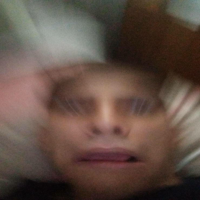

In [ ]:
# Resize image 29
path = 'testset/'
image = Image.open(path + '29.png')
new_image = image.resize((200, 200))
new_image.save(path + '29_resized.png')

print(image.size) # Output: (1920, 1280)
print(new_image.size) # Output: (200, 200)

# Detect faces
detected_faces = RetinaFace.detect_faces(path + '29_resized.png')
# Draw bounding boxes
img = cv2.imread(path + '29_resized.png')
try:
    boxes = [f[1]['Facial_area'] for f in detected_faces.items()]
    for box in boxes:
        img = cv2.rectangle(img, box[:2], box[2:], color=(0,0,255), thickness=5)
except:
    print('No face detected in 29_resized.png')
cv2_imshow(img)

### Images with different angles

  0%|          | 0/10 [00:00<?, ?it/s]

No face detected in testset/31.jpg


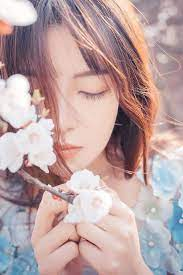

 10%|█         | 1/10 [00:07<01:08,  7.57s/it]

No face detected in testset/32.jpg


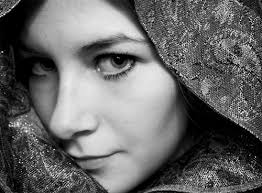

 20%|██        | 2/10 [00:14<00:56,  7.03s/it]

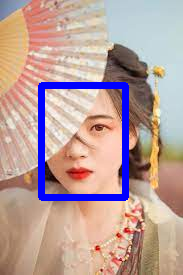

 30%|███       | 3/10 [00:21<00:50,  7.20s/it]

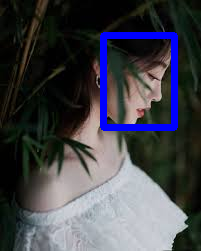

 40%|████      | 4/10 [00:27<00:40,  6.77s/it]

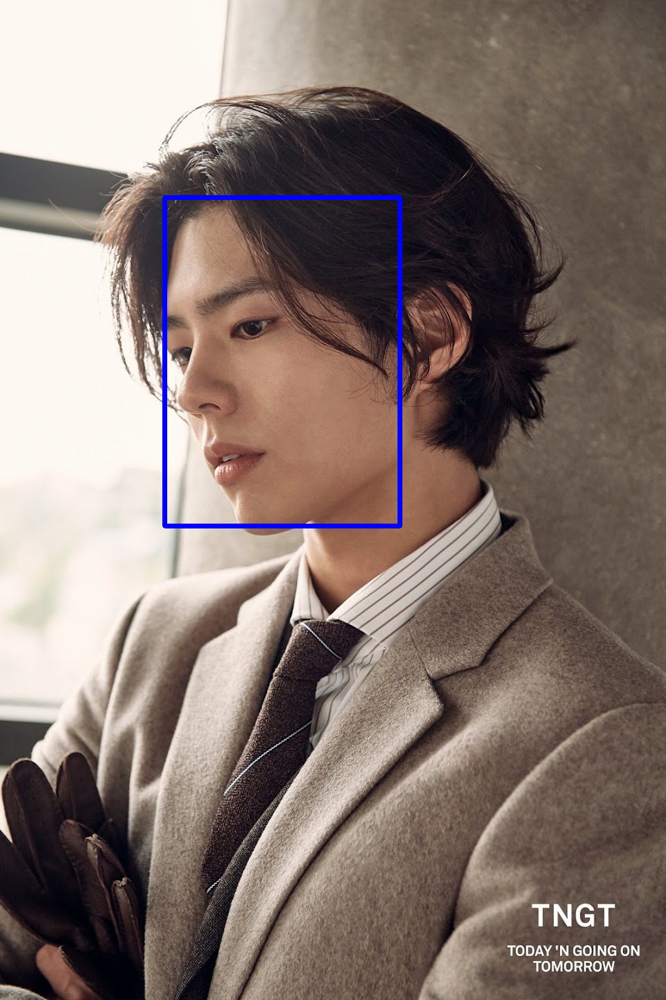

 50%|█████     | 5/10 [00:37<00:38,  7.69s/it]

No face detected in testset/36.jpg


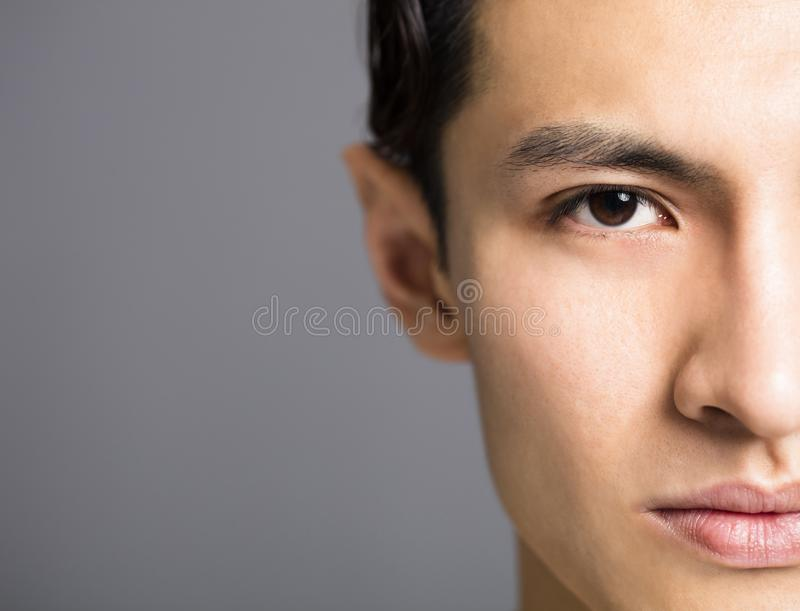

 60%|██████    | 6/10 [00:43<00:29,  7.42s/it]

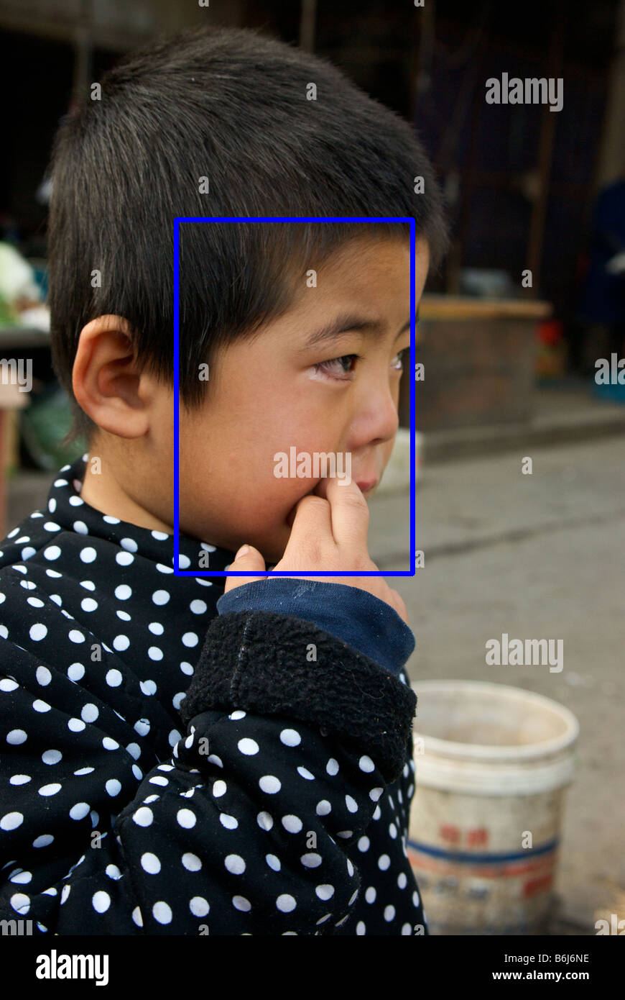

 70%|███████   | 7/10 [00:52<00:23,  7.70s/it]

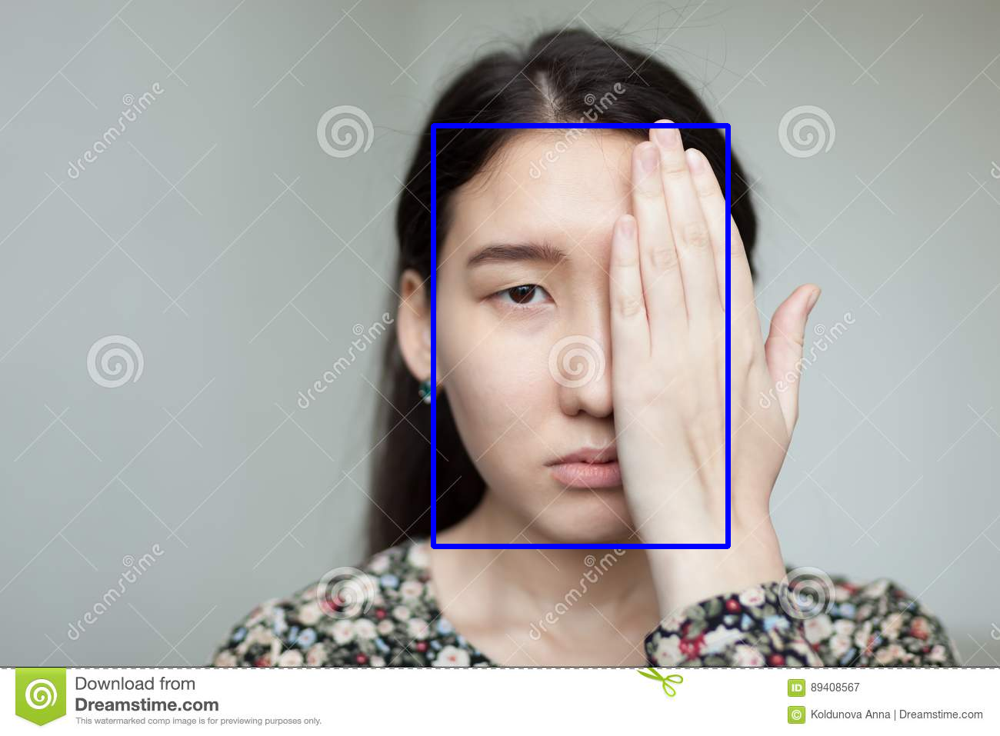

 80%|████████  | 8/10 [00:59<00:15,  7.53s/it]

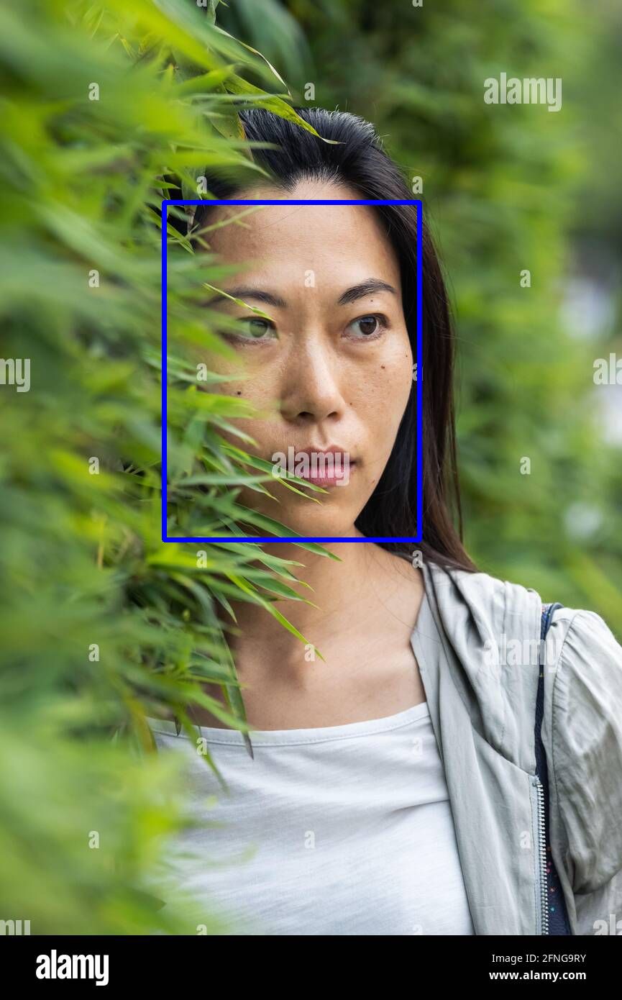

 90%|█████████ | 9/10 [01:07<00:07,  7.82s/it]

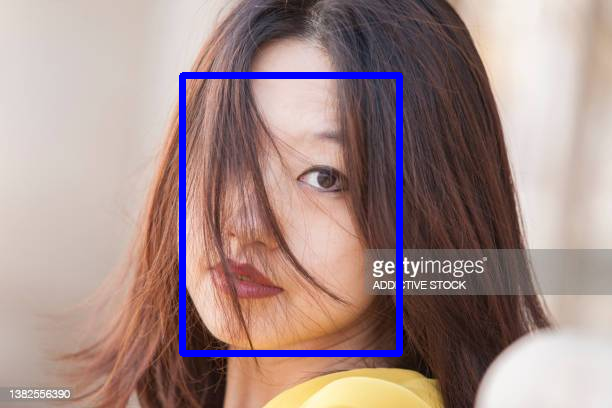

100%|██████████| 10/10 [01:15<00:00,  7.55s/it]

Acc: 7/20


In [ ]:
test_size = 10  # Number of pictures in testset
detectable = 0  # Number of pictures having detected faces
path = 'testset/'
for i in tqdm(range(31, 41)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img_path)
    # Draw faces' bounding box on image 
    img = cv2.imread(img_path)
    try:
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]
        for box in boxes:
            img = cv2.rectangle(img, box[:2], box[2:], color=(255,0,0), thickness=5)
        detectable += 1
    except:
        print('No face detected in ' + img_path)
    cv2_imshow(img)
print(f'\nAcc: {detectable}/{test_size}')

### Images with changing brightness

  0%|          | 0/20 [00:00<?, ?it/s]

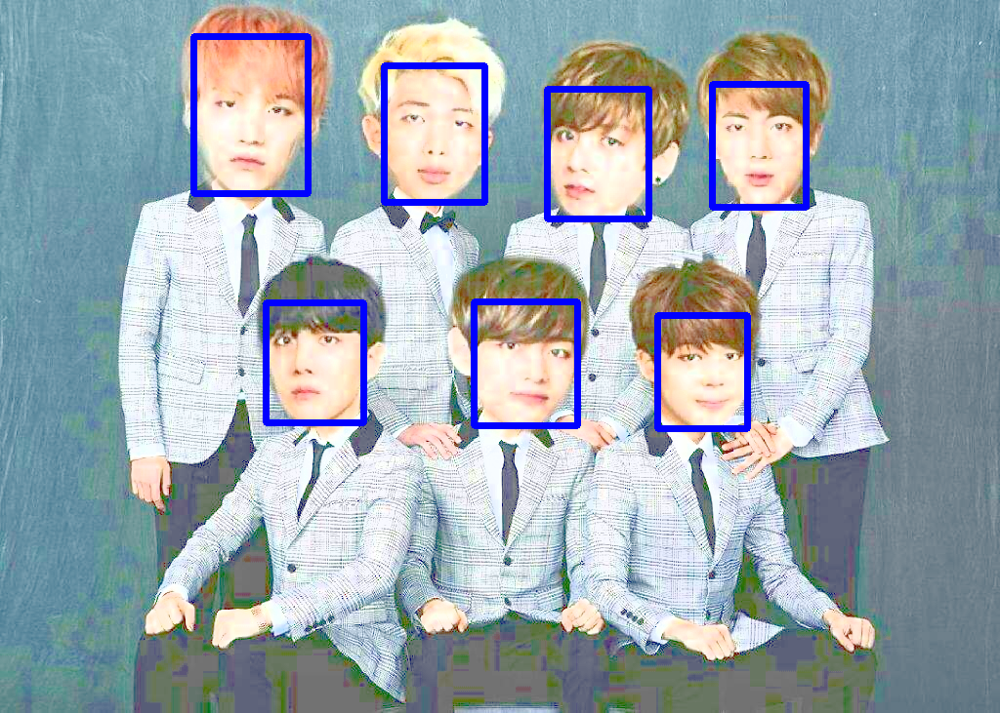

  5%|▌         | 1/20 [00:15<04:59, 15.79s/it]

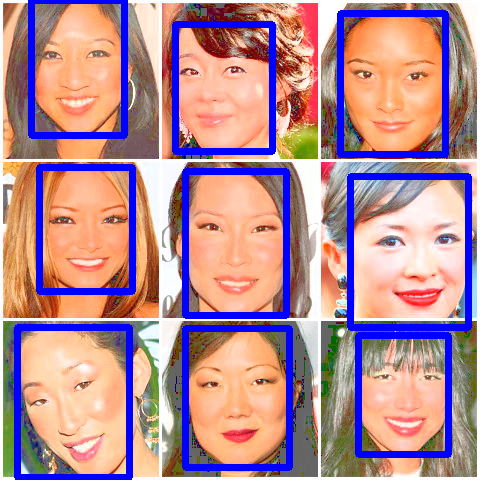

 10%|█         | 2/20 [00:27<04:02, 13.47s/it]

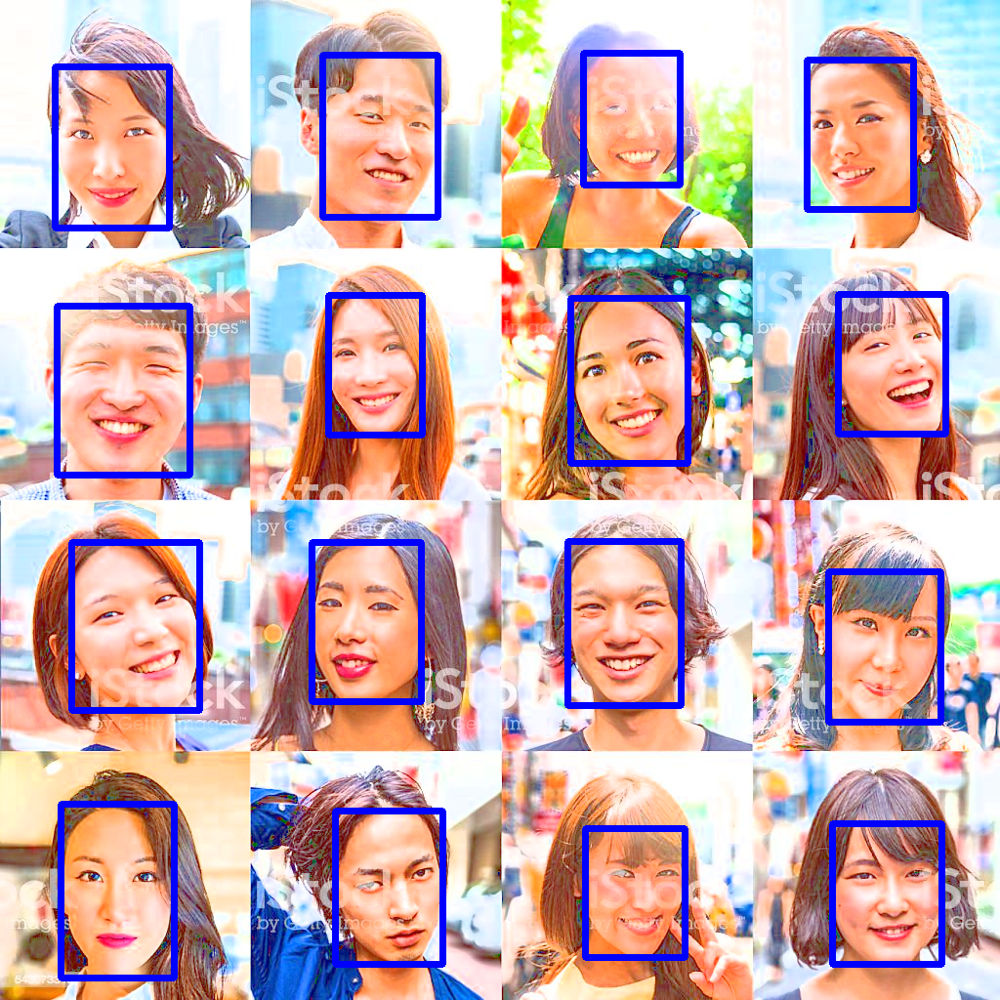

 15%|█▌        | 3/20 [00:38<03:25, 12.10s/it]

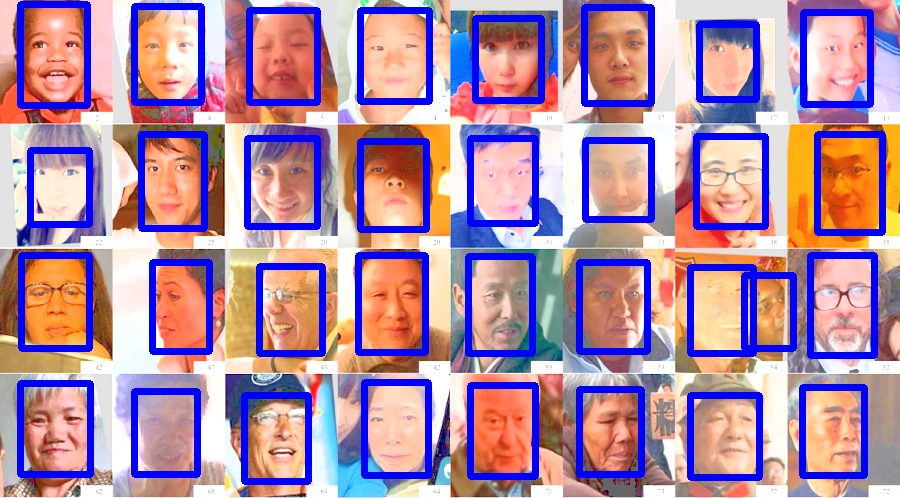

 20%|██        | 4/20 [00:56<03:52, 14.55s/it]

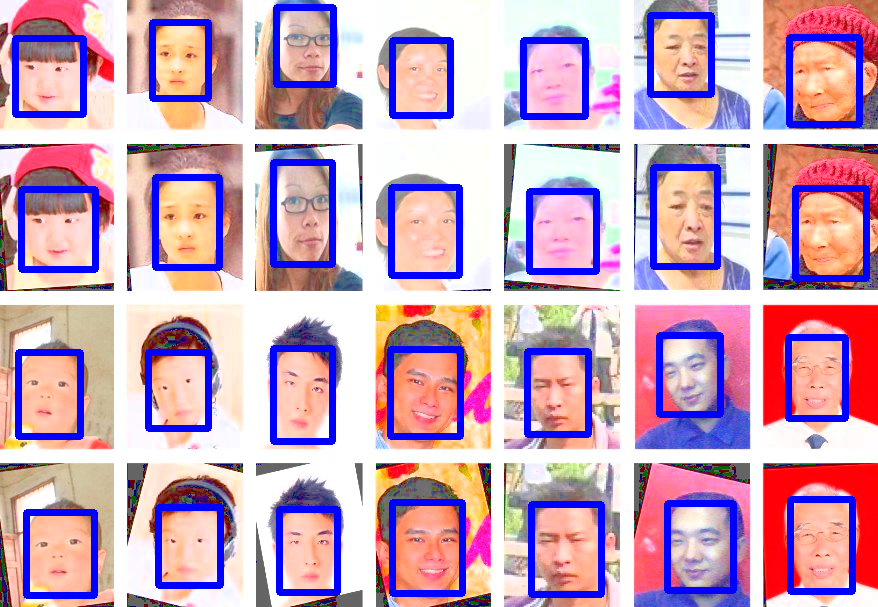

 25%|██▌       | 5/20 [01:12<03:47, 15.13s/it]

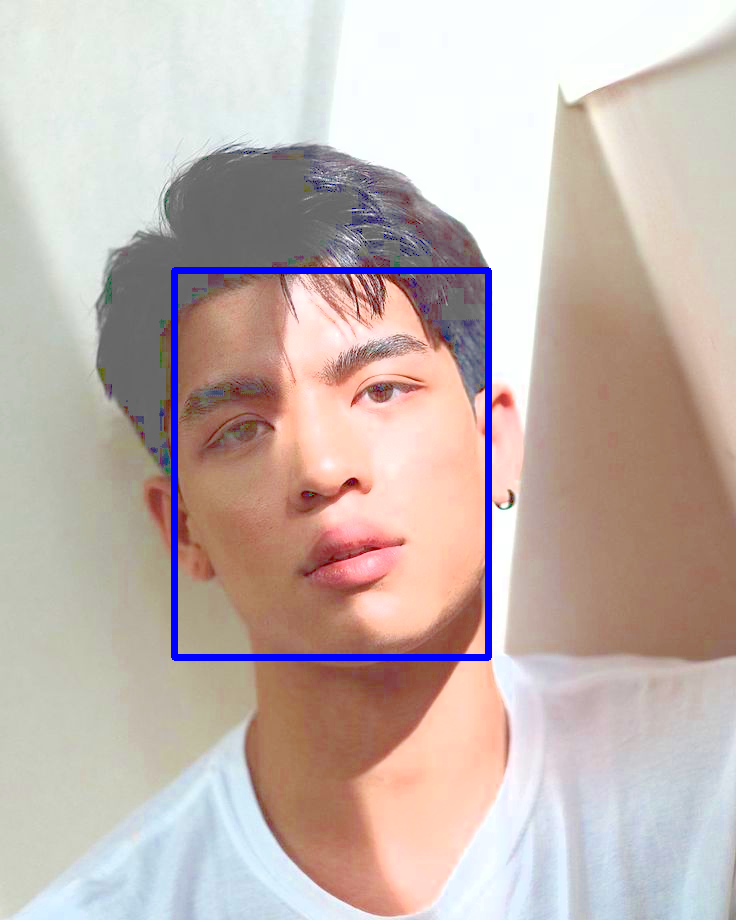

 30%|███       | 6/20 [01:25<03:19, 14.26s/it]

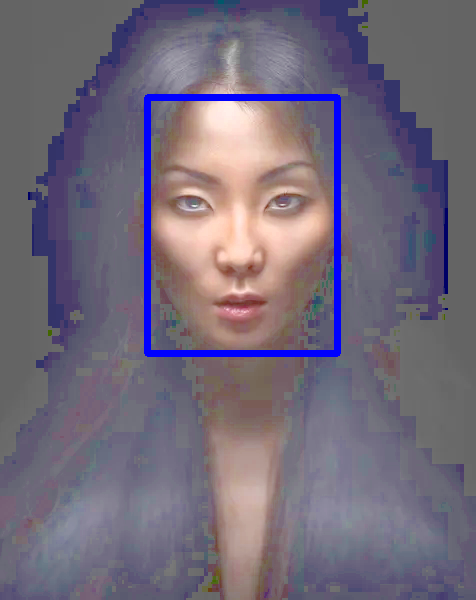

 35%|███▌      | 7/20 [01:37<02:58, 13.71s/it]

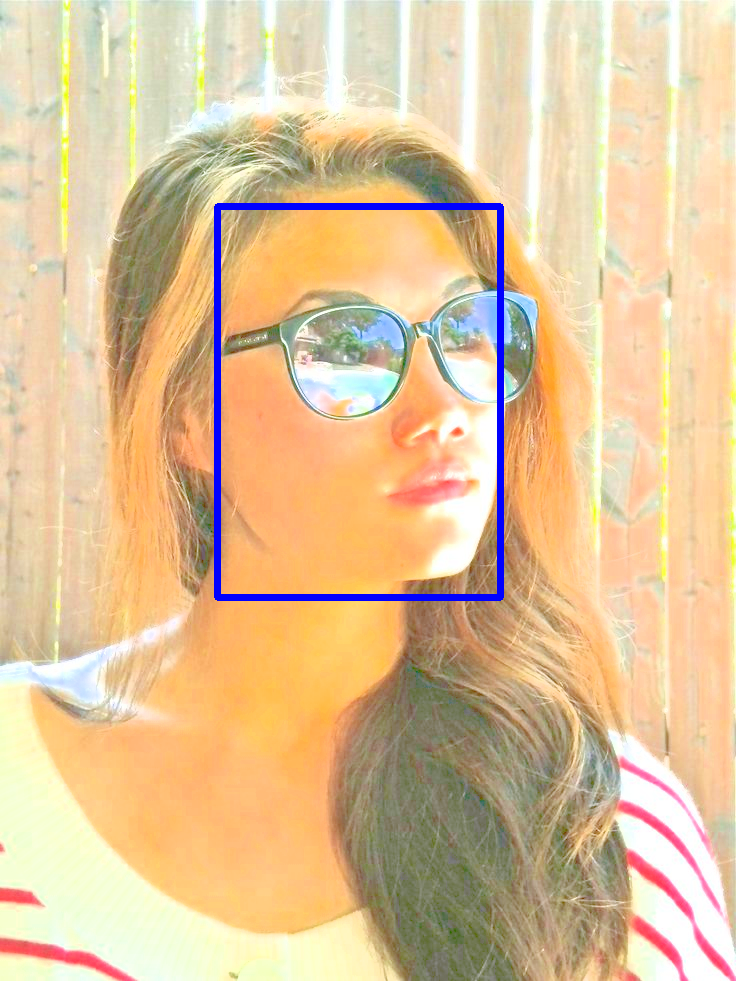

 40%|████      | 8/20 [01:52<02:46, 13.91s/it]

No face detected in testset/9.jpg


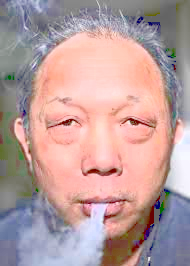

 45%|████▌     | 9/20 [02:06<02:36, 14.19s/it]

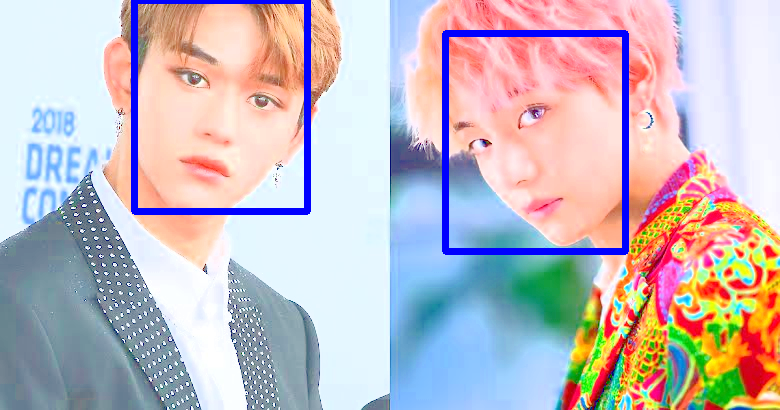

 50%|█████     | 10/20 [02:25<02:36, 15.64s/it]

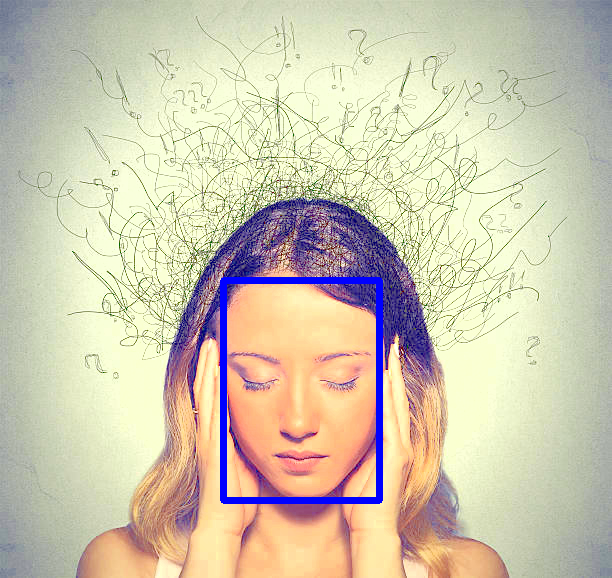

 55%|█████▌    | 11/20 [02:40<02:17, 15.31s/it]

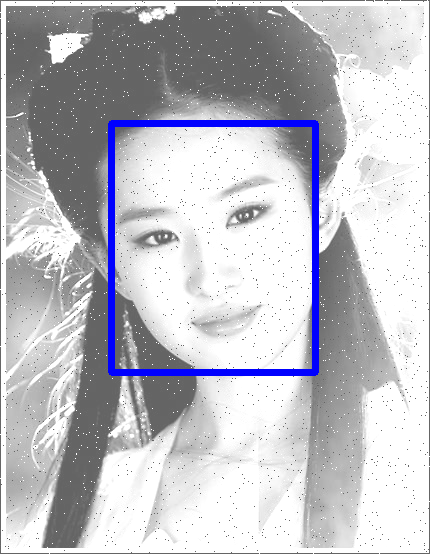

 60%|██████    | 12/20 [02:55<02:02, 15.37s/it]

No face detected in testset/13.png


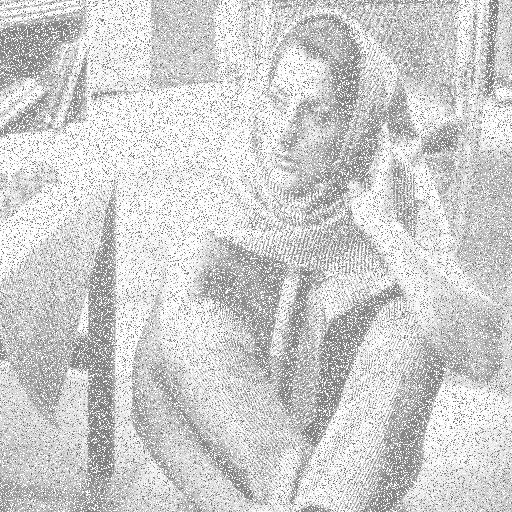

 65%|██████▌   | 13/20 [03:06<01:36, 13.82s/it]

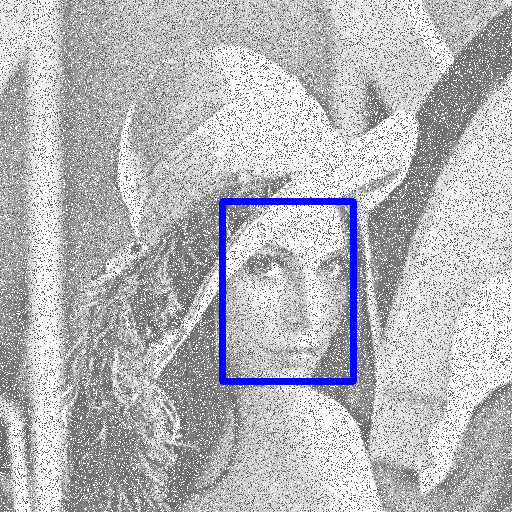

 70%|███████   | 14/20 [03:16<01:16, 12.75s/it]

No face detected in testset/15.jpg


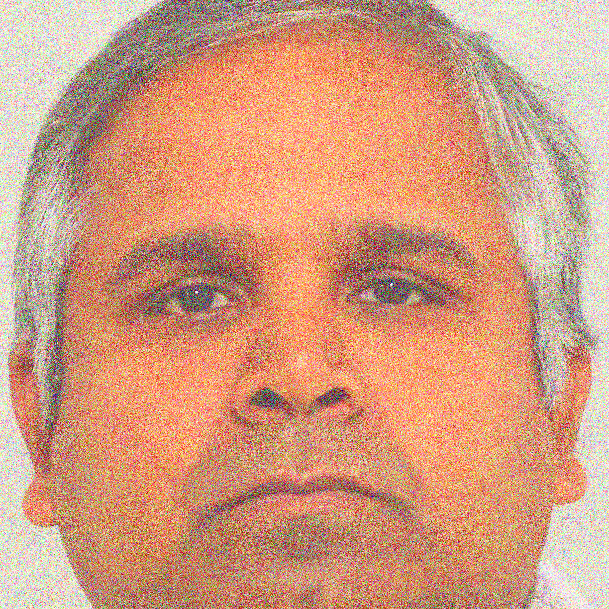

 75%|███████▌  | 15/20 [03:26<01:00, 12.01s/it]

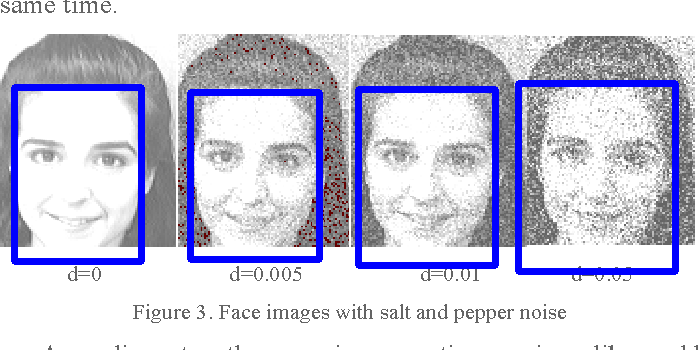

 80%|████████  | 16/20 [03:47<00:58, 14.65s/it]

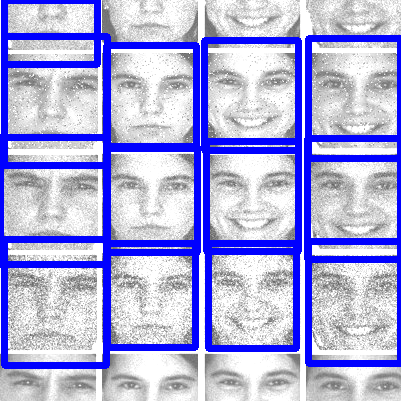

 85%|████████▌ | 17/20 [04:01<00:43, 14.38s/it]

No face detected in testset/18.png


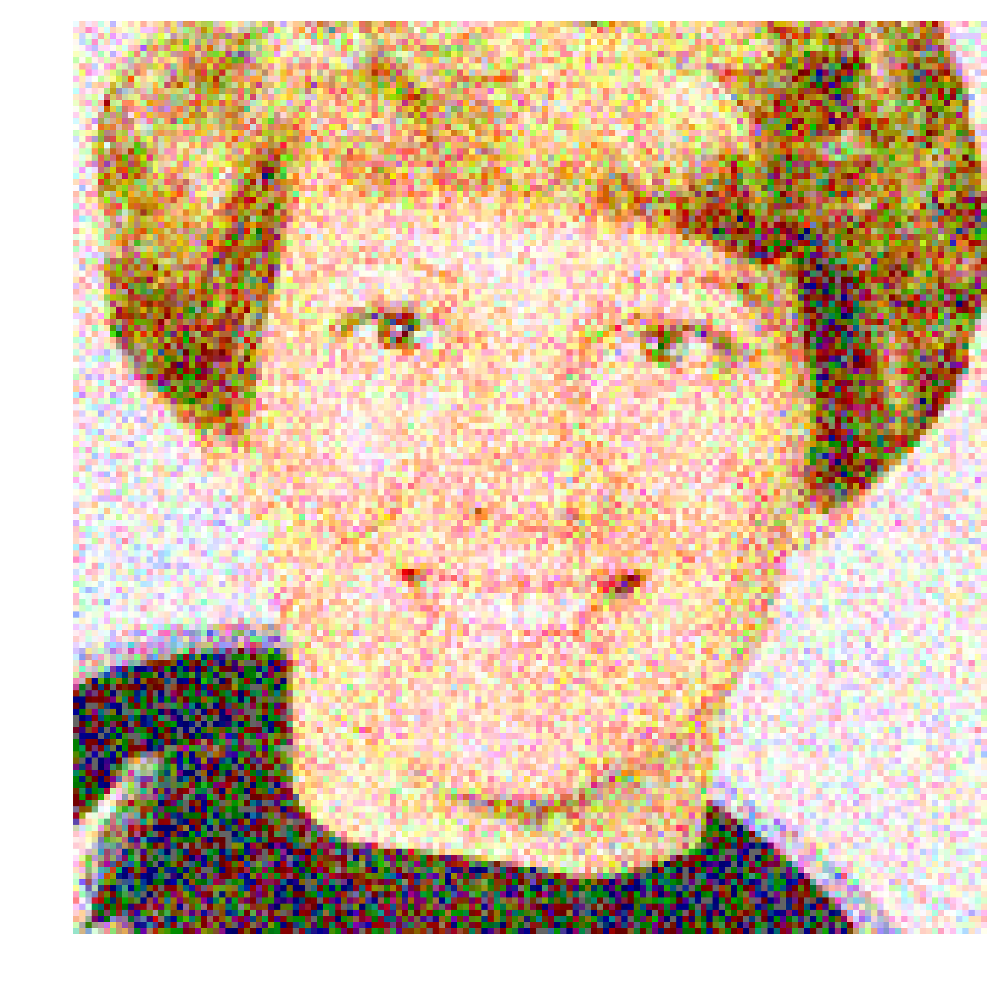

 90%|█████████ | 18/20 [04:19<00:30, 15.44s/it]

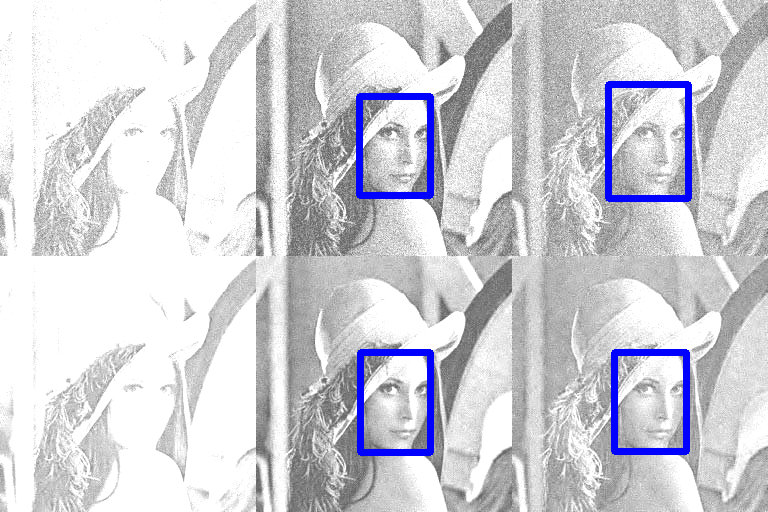

 95%|█████████▌| 19/20 [04:38<00:16, 16.72s/it]

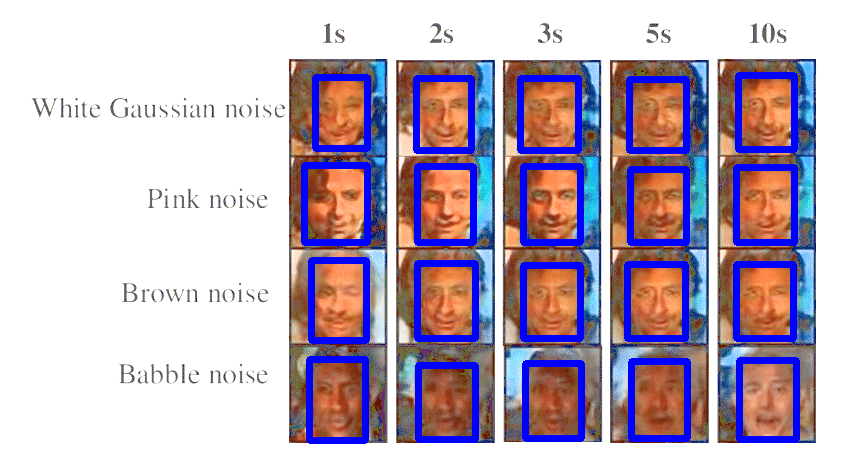

100%|██████████| 20/20 [04:58<00:00, 14.94s/it]


Number of faces before: 154
Number of faces after: 150


In [ ]:
# Test with brighter images
def increase_brightness(img, value=50):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)      # hsv = hue, saturation, value (brightness)
    h, s, v = cv2.split(hsv)

    lim = 255 - value
    v[v > lim] = 255
    v[v <= lim] += value

    final_hsv = cv2.merge((h, s, v))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return img


detectable_before = 0       # Number of faces detected before changing 
detectable_after = 0        # Number of faces detected after changing
path = 'testset/'
for i in tqdm(range(1, test_size + 1)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    img = cv2.imread(img_path)
    # Count number of faces that can be detected before changing brightness
    detected_faces = RetinaFace.detect_faces(img)
    detectable_before += len(detected_faces)
    # Increase brightness
    img = increase_brightness(cv2.imread(img_path), 100)
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img)
    detectable_after += len(detected_faces)
    # Draw faces' bounding box on image 
    try:
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]
        for box in boxes:
            img = cv2.rectangle(img, box[:2], box[2:], color=(255,0,0), thickness=5)
    except:
        print('No face detected in ' + img_path)
    cv2_imshow(img)
print(f'\nNumber of faces before: {detectable_before}\nNumber of faces after: {detectable_after}')

  0%|          | 0/20 [00:00<?, ?it/s]

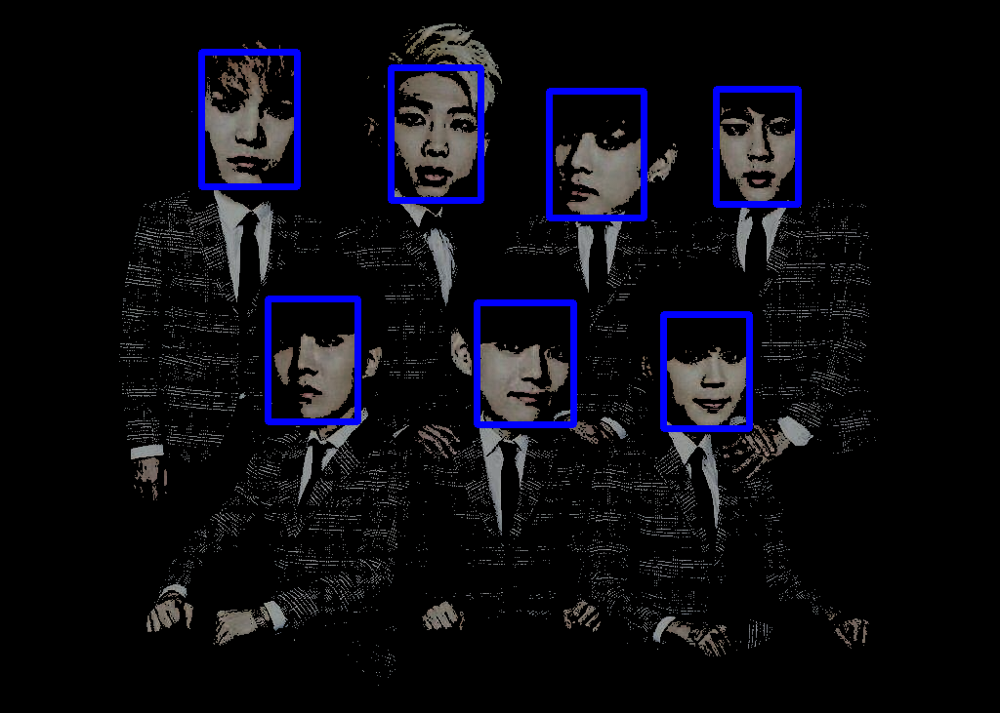

  5%|▌         | 1/20 [00:14<04:34, 14.42s/it]

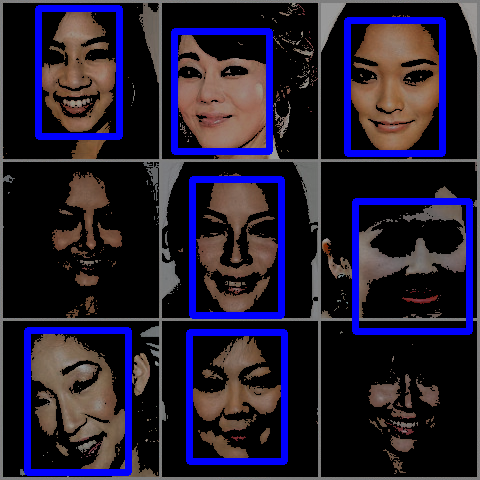

 10%|█         | 2/20 [00:25<03:48, 12.68s/it]

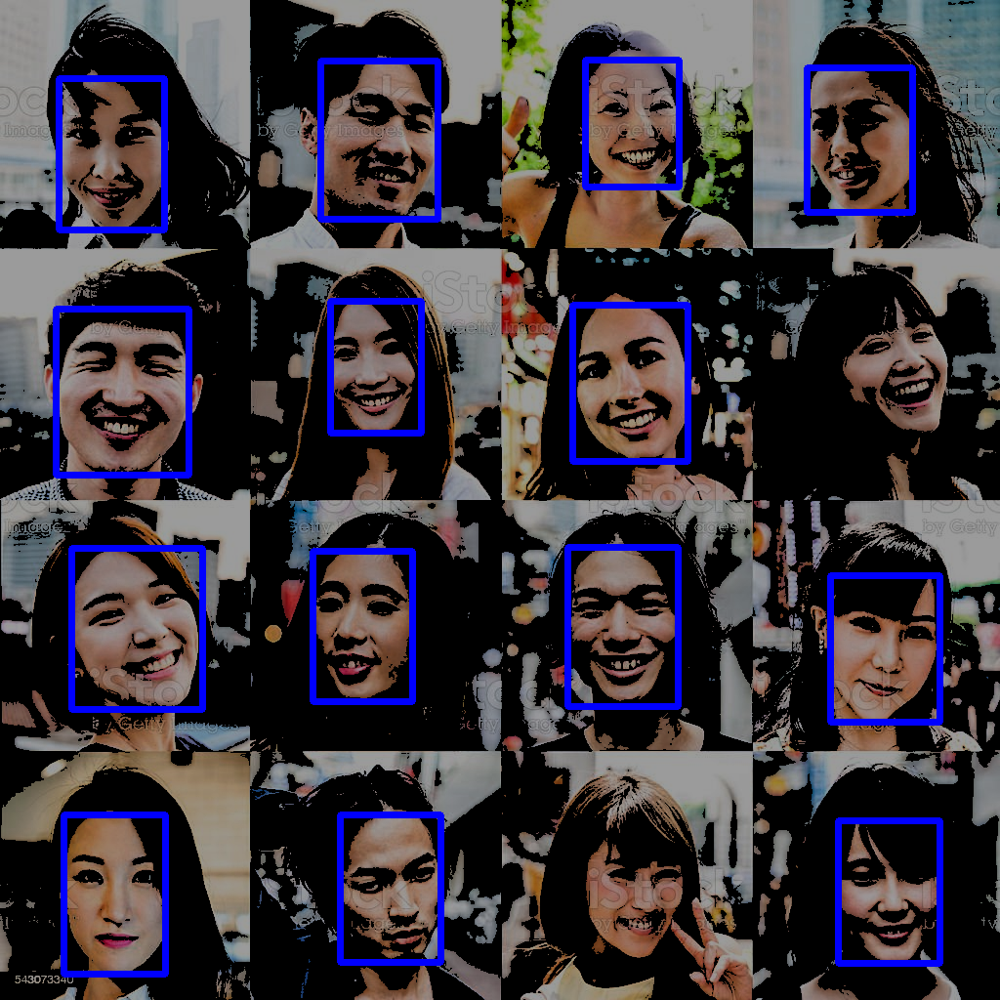

 15%|█▌        | 3/20 [00:37<03:27, 12.18s/it]

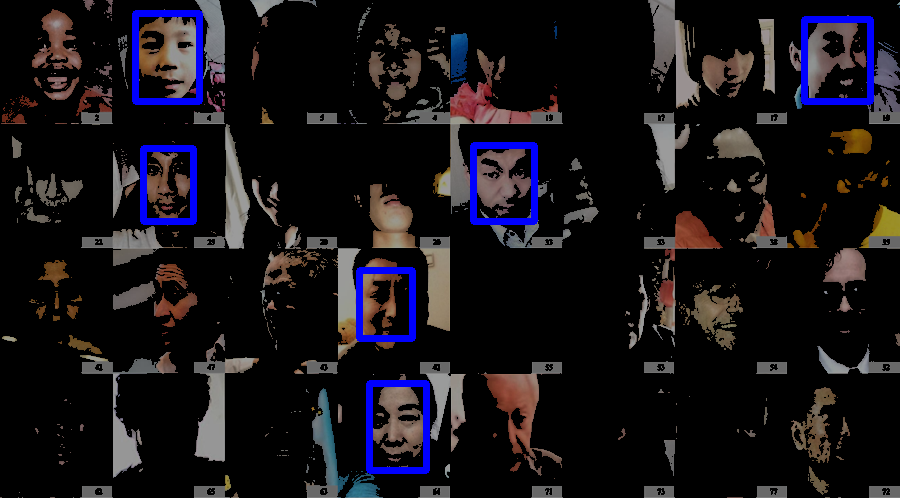

 20%|██        | 4/20 [00:55<03:54, 14.65s/it]

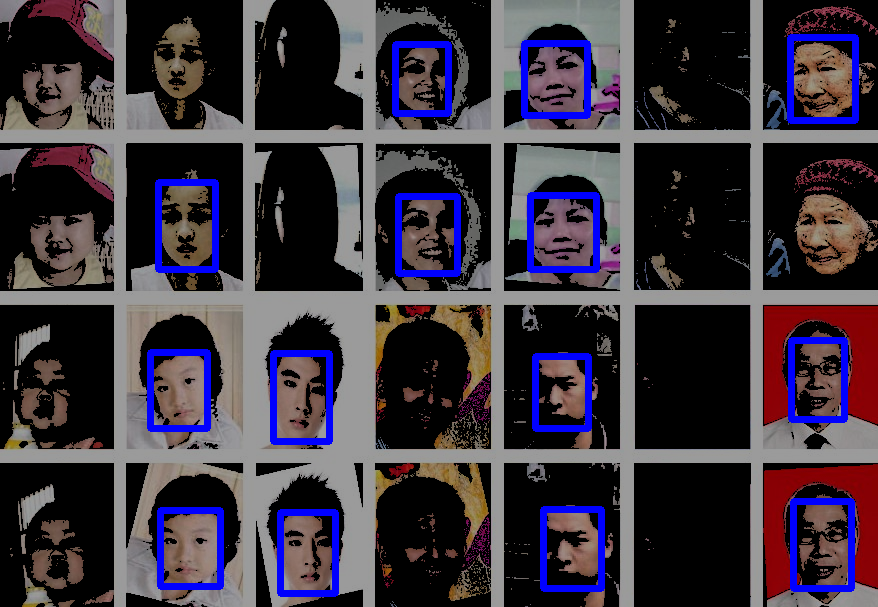

 25%|██▌       | 5/20 [01:10<03:38, 14.58s/it]

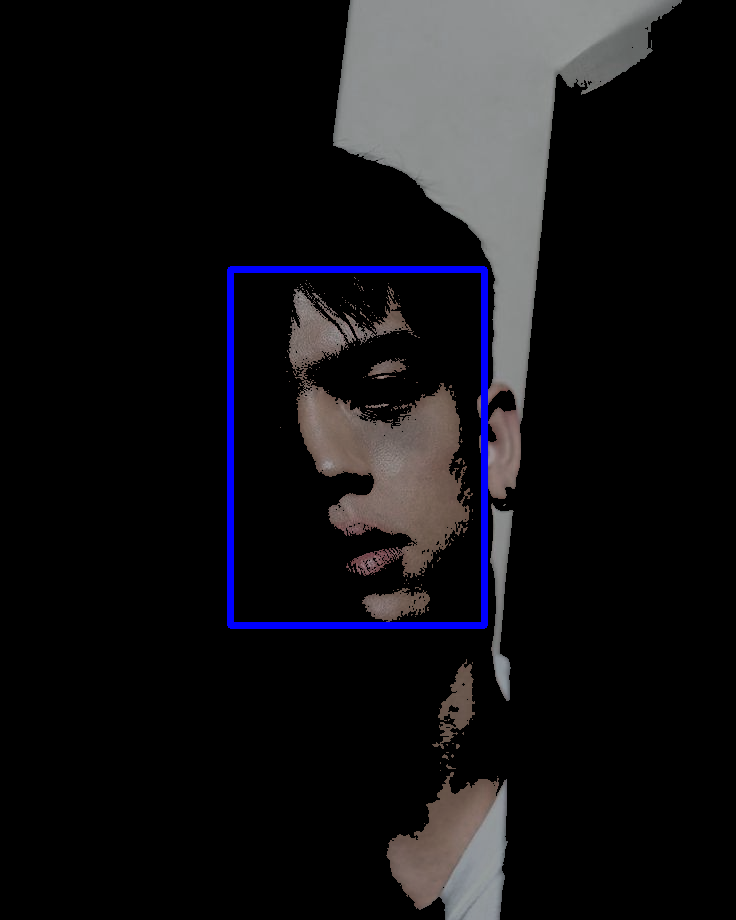

 30%|███       | 6/20 [01:24<03:21, 14.36s/it]

No face detected in testset/7.jpg


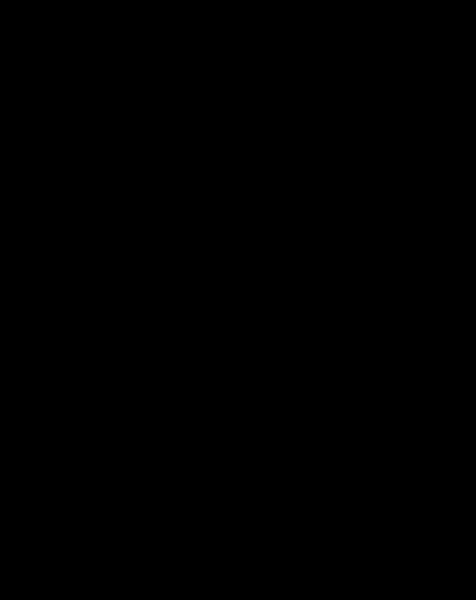

 35%|███▌      | 7/20 [01:36<02:58, 13.75s/it]

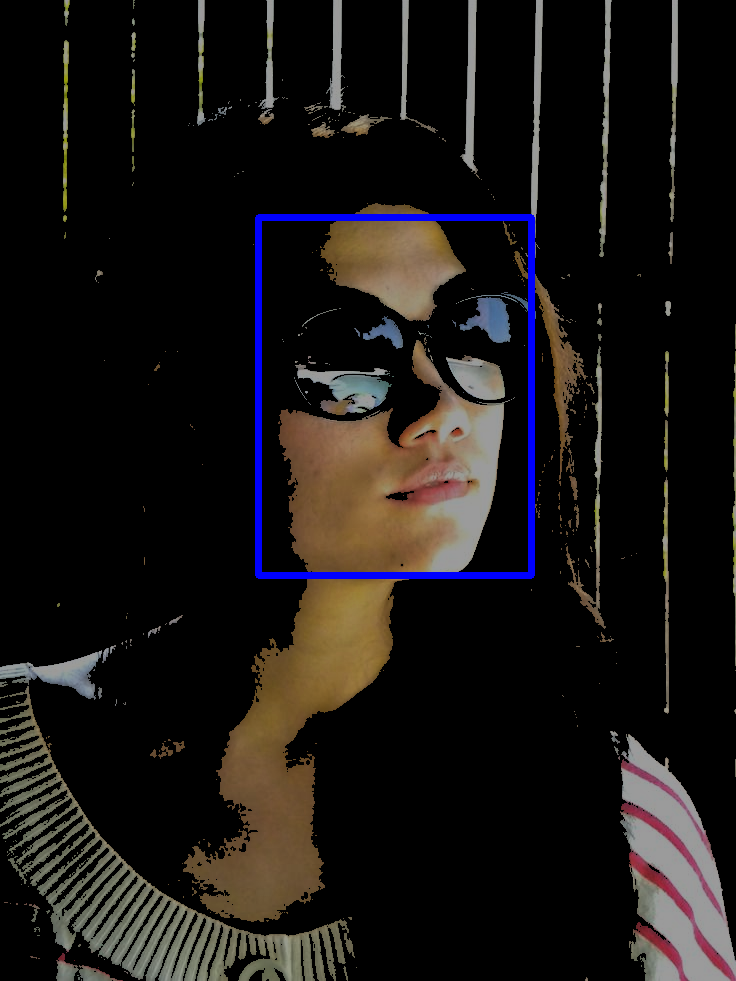

 40%|████      | 8/20 [01:50<02:43, 13.62s/it]

No face detected in testset/9.jpg


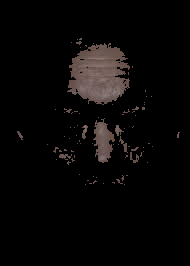

 45%|████▌     | 9/20 [02:03<02:30, 13.68s/it]

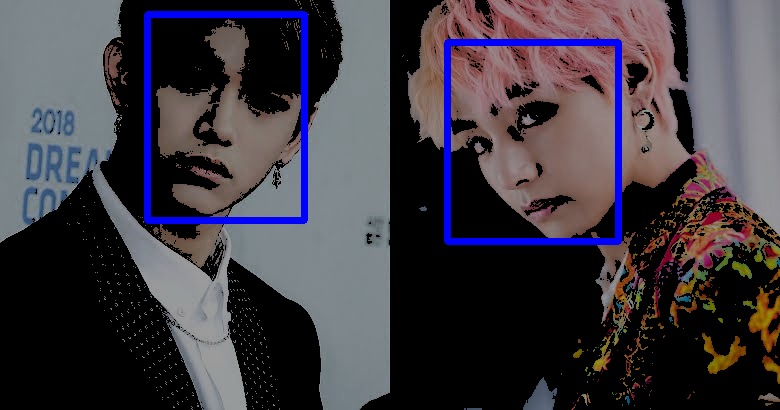

 50%|█████     | 10/20 [02:25<02:40, 16.04s/it]

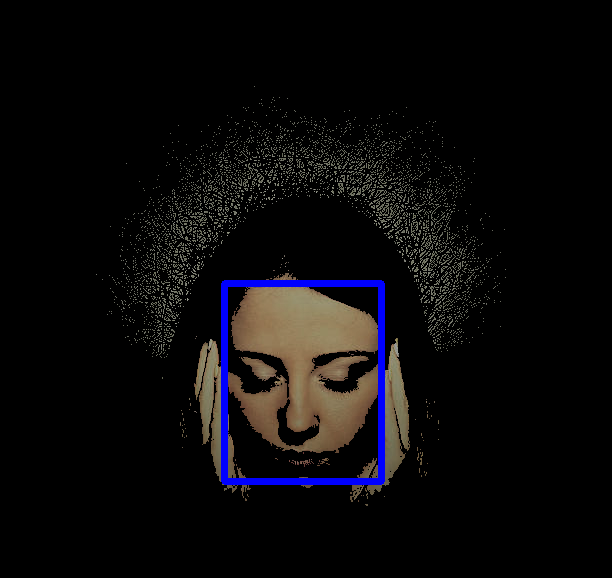

 55%|█████▌    | 11/20 [02:35<02:09, 14.40s/it]

No face detected in testset/12.jpg


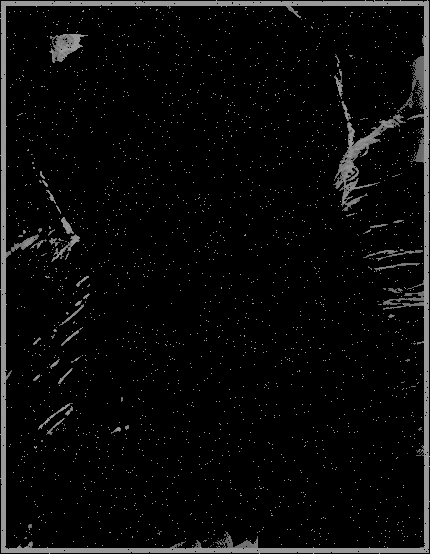

 60%|██████    | 12/20 [02:48<01:51, 13.90s/it]

No face detected in testset/13.png


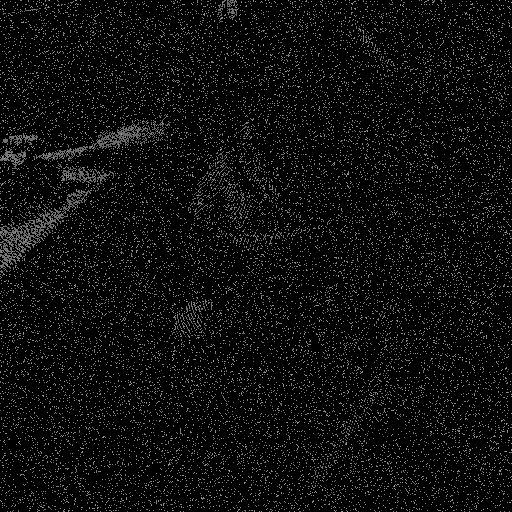

 65%|██████▌   | 13/20 [03:00<01:32, 13.17s/it]

No face detected in testset/14.png


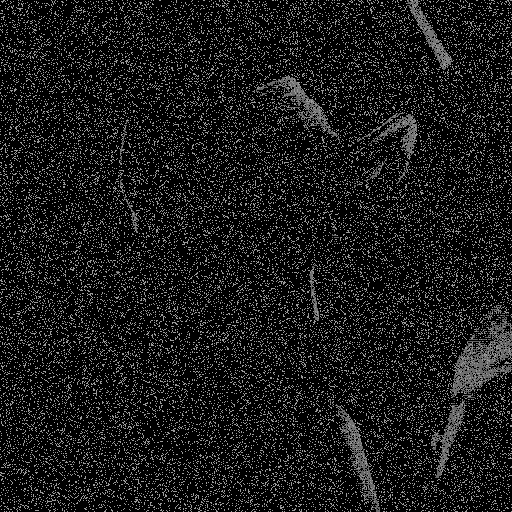

 70%|███████   | 14/20 [03:10<01:13, 12.22s/it]

No face detected in testset/15.jpg


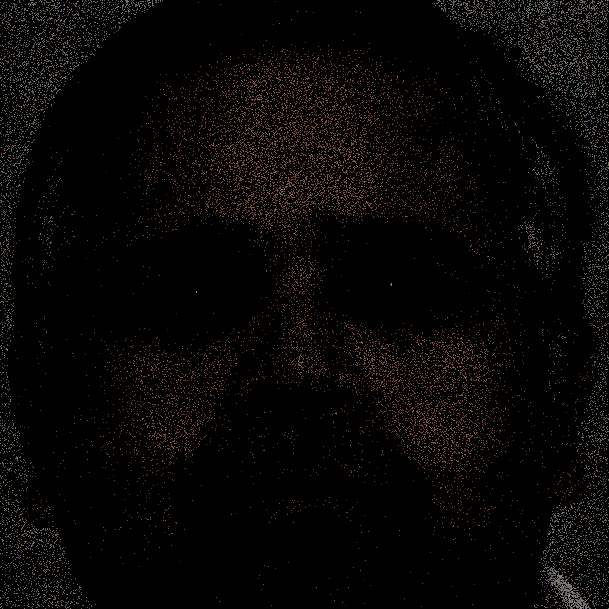

 75%|███████▌  | 15/20 [03:20<00:57, 11.60s/it]

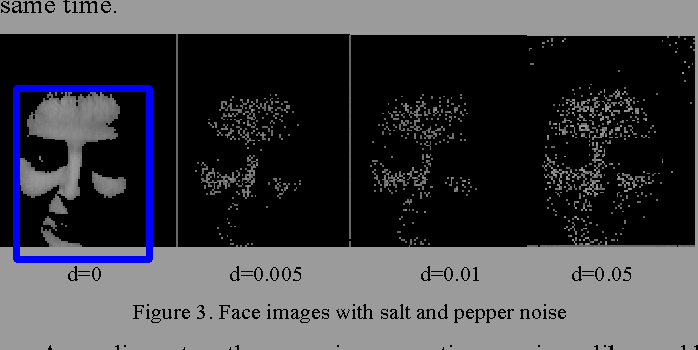

 80%|████████  | 16/20 [03:38<00:54, 13.69s/it]

No face detected in testset/17.jpg


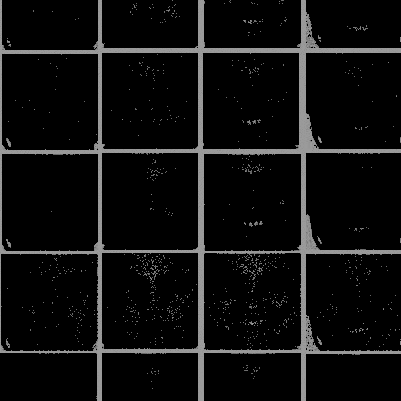

 85%|████████▌ | 17/20 [03:51<00:40, 13.36s/it]

No face detected in testset/18.png


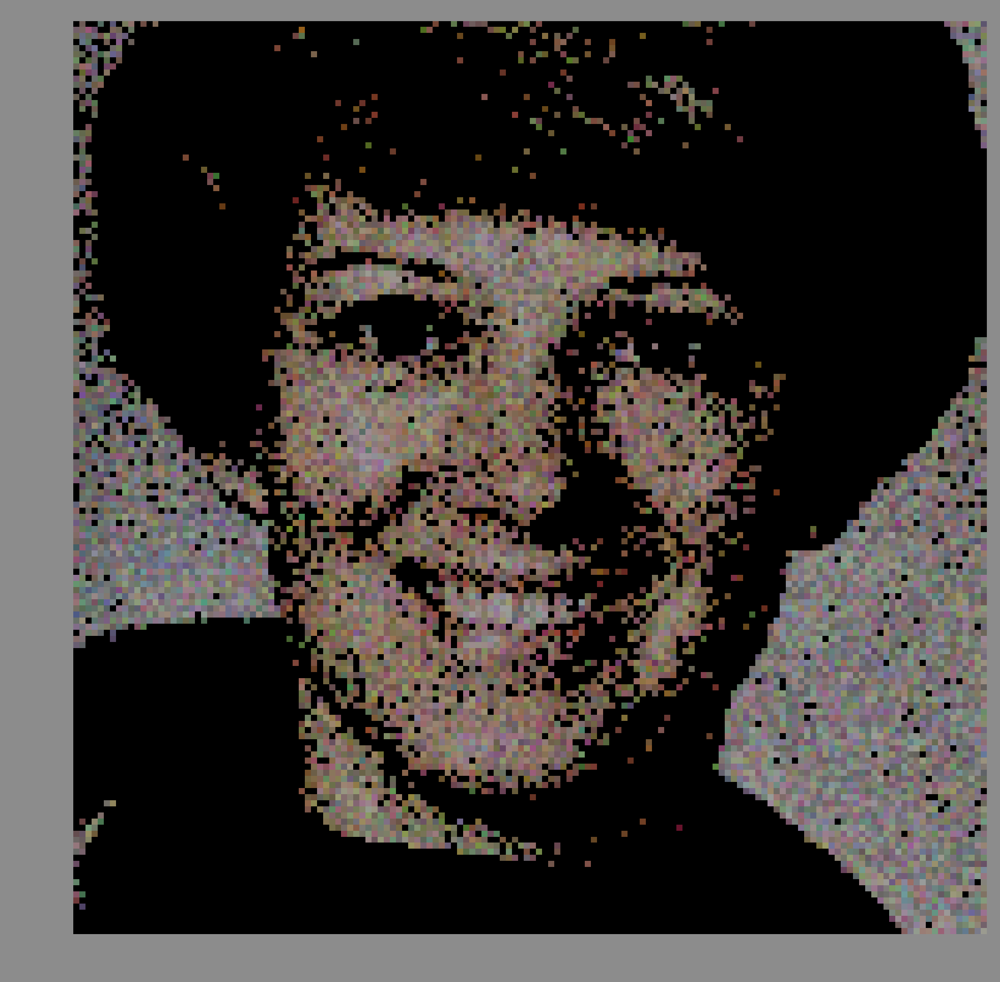

 90%|█████████ | 18/20 [04:02<00:25, 12.67s/it]

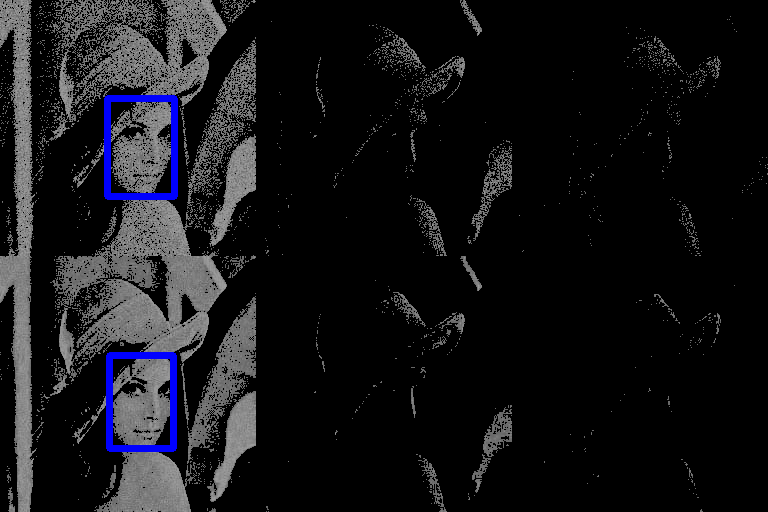

 95%|█████████▌| 19/20 [04:17<00:13, 13.28s/it]

No face detected in testset/20.png


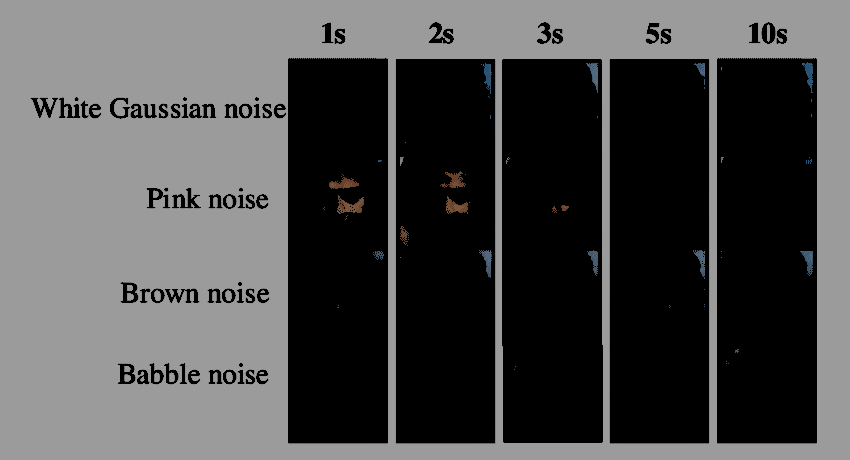

100%|██████████| 20/20 [04:40<00:00, 14.02s/it]

Acc before: 154
Acc after: 74


In [ ]:
# Test with darker images
def decrease_brightness(img, value=100):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    v[v >= value] -= value
    v[v < value] = 0

    final_hsv = cv2.merge((h, s, v))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return img

detectable_before = 0       # Number of faces detected before changing 
detectable_after = 0        # Number of faces detected after changing
path = 'testset/'
for i in tqdm(range(1, test_size + 1)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    img = cv2.imread(img_path)
    # Count number of faces that can be detected before changing brightness
    detected_faces = RetinaFace.detect_faces(img)
    detectable_before += len(detected_faces)
    # Increase brightness
    img = decrease_brightness(cv2.imread(img_path), 100)
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img)
    detectable_after += len(detected_faces)
    # Draw faces' bounding box on image 
    try:
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]
        for box in boxes:
            img = cv2.rectangle(img, box[:2], box[2:], color=(255,0,0), thickness=5)
    except:
        print('No face detected in ' + img_path)
    cv2_imshow(img)
print(f'\nNumber of faces before: {detectable_before}\nNumber of faces after: {detectable_after}')

### Images alignment

  0%|          | 0/40 [00:00<?, ?it/s]

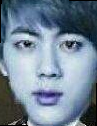

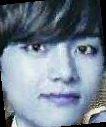

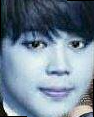

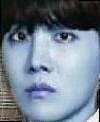

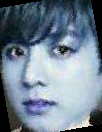

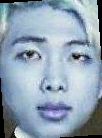

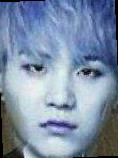

  2%|▎         | 1/40 [00:07<05:09,  7.93s/it]

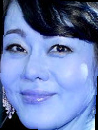

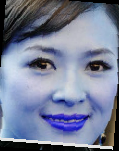

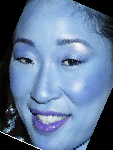

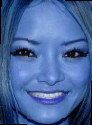

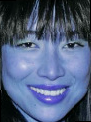

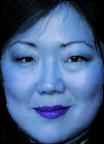

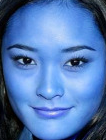

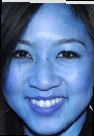

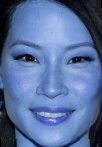

  5%|▌         | 2/40 [00:13<03:57,  6.25s/it]

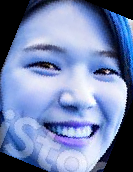

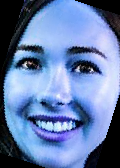

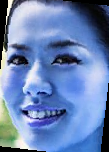

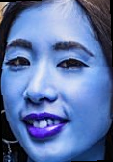

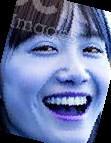

...

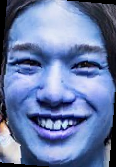

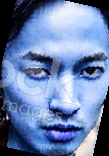

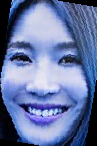

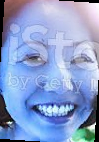

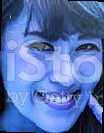

  8%|▊         | 3/40 [00:18<03:34,  5.79s/it]

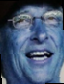

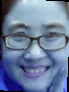

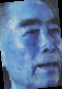

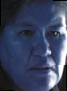

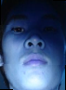

...

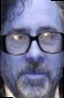

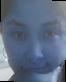

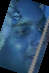

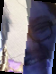

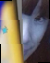

 10%|█         | 4/40 [00:28<04:26,  7.39s/it]

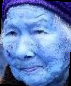

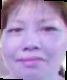

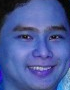

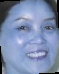

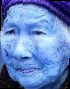

...

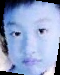

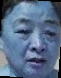

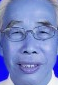

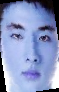

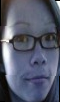

 12%|█▎        | 5/40 [00:35<04:22,  7.49s/it]

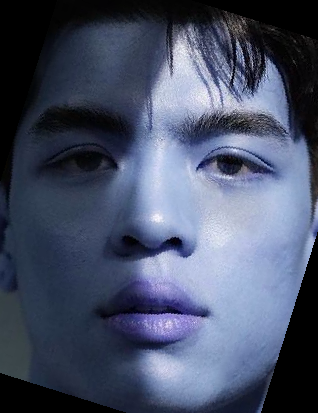

 15%|█▌        | 6/40 [00:42<04:03,  7.16s/it]

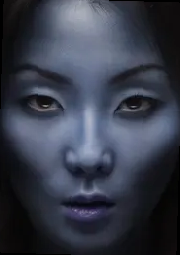

 18%|█▊        | 7/40 [00:48<03:46,  6.85s/it]

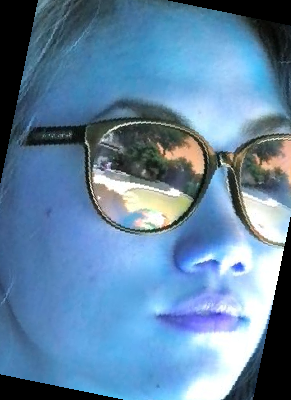

 22%|██▎       | 9/40 [01:01<03:30,  6.78s/it]

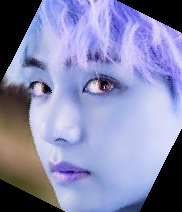

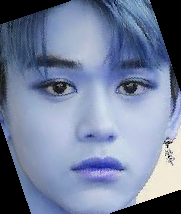

 25%|██▌       | 10/40 [01:11<03:45,  7.52s/it]

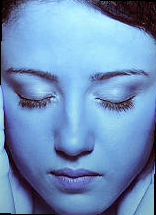

 28%|██▊       | 11/40 [01:16<03:18,  6.83s/it]

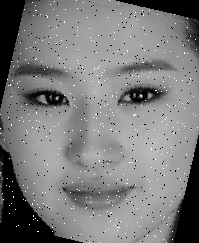

 35%|███▌      | 14/40 [01:32<02:29,  5.75s/it]

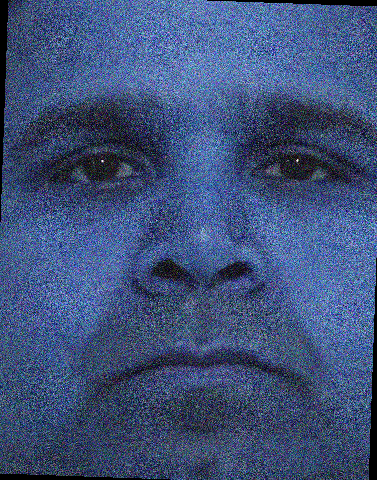

 38%|███▊      | 15/40 [01:37<02:17,  5.50s/it]

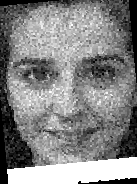

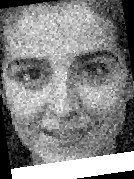

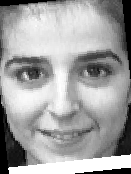

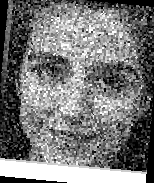

 40%|████      | 16/40 [01:47<02:43,  6.80s/it]

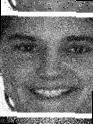

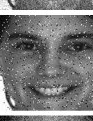

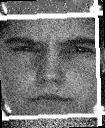

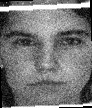

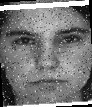

...

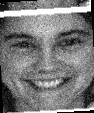

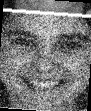

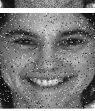

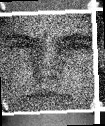

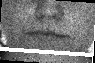

 45%|████▌     | 18/40 [01:57<02:13,  6.05s/it]

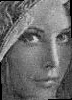

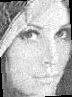

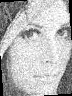

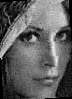

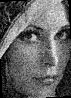

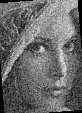

 48%|████▊     | 19/40 [02:05<02:14,  6.43s/it]

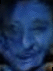

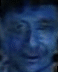

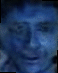

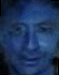

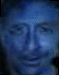

...

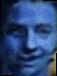

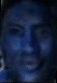

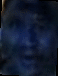

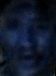

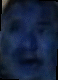

 50%|█████     | 20/40 [02:14<02:26,  7.32s/it]

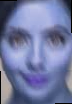

 52%|█████▎    | 21/40 [02:22<02:24,  7.62s/it]

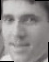

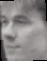

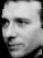

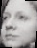

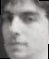

...

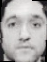

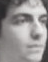

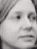

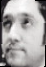

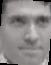

 55%|█████▌    | 22/40 [02:35<02:42,  9.01s/it]

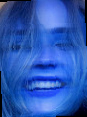

 57%|█████▊    | 23/40 [02:46<02:47,  9.87s/it]

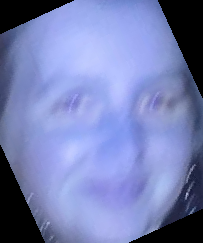

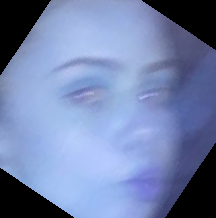

 60%|██████    | 24/40 [02:57<02:41, 10.07s/it]

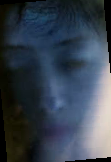

 62%|██████▎   | 25/40 [03:06<02:24,  9.66s/it]

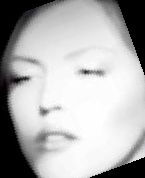

 68%|██████▊   | 27/40 [03:20<01:51,  8.55s/it]

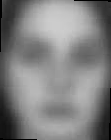

 72%|███████▎  | 29/40 [03:34<01:25,  7.80s/it]

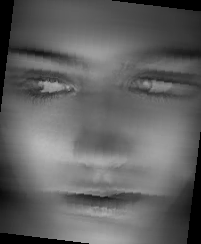

 80%|████████  | 32/40 [03:56<00:59,  7.39s/it]

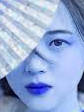

 82%|████████▎ | 33/40 [04:03<00:51,  7.36s/it]

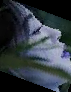

 85%|████████▌ | 34/40 [04:09<00:41,  6.99s/it]

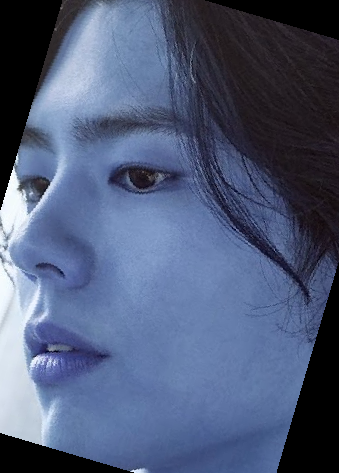

 90%|█████████ | 36/40 [04:27<00:30,  7.67s/it]

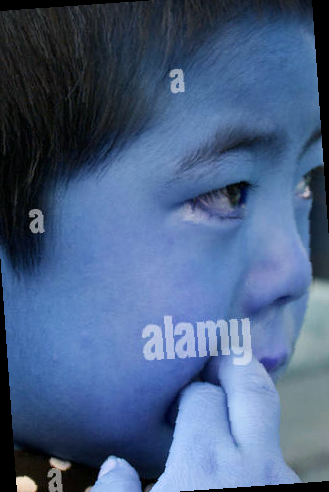

 92%|█████████▎| 37/40 [04:34<00:23,  7.71s/it]

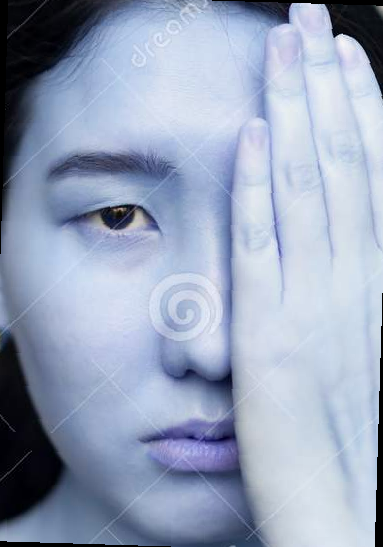

 95%|█████████▌| 38/40 [04:41<00:14,  7.42s/it]

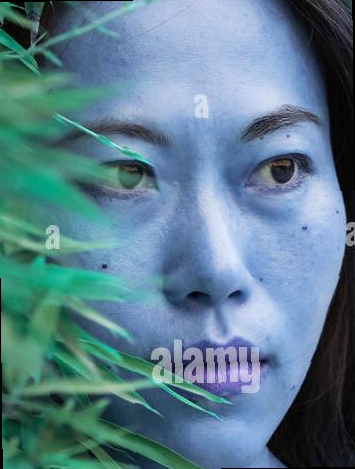

 98%|█████████▊| 39/40 [04:49<00:07,  7.56s/it]

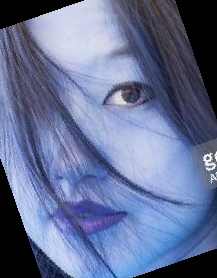

100%|██████████| 40/40 [04:56<00:00,  7.42s/it]


In [ ]:
path = 'testset/'
for i in tqdm(range(1, 41)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    extracted_faces = RetinaFace.extract_faces(img_path=img_path, align=True)
    for face in extracted_faces:
        plt.imshow(face)
        plt.show()

### Face landmarks detection

In [ ]:
path = 'testset/'
for i in tqdm(range(1, 41)):
    try:
        img_path = path + str(i) + '.jpg'
        f = open(img_path)
        f.close()
    except:
        img_path = path + str(i) + '.png'
    # Detect faces
    detected_faces = RetinaFace.detect_faces(img_path)
    # Draw faces' bounding box on image 
    img = cv2.imread(img_path)
    try:
        landmarks = []
        for face in detected_faces.items():
            landmarks.extend(face[1]['landmarks'].values())
        for landmark in landmarks:
            img = cv2.circle(img, (round(landmark[0]), round(landmark[1])), 5, (255,255,255), -1)
    except:
        pass
    cv2_imshow(img)

### Video clips

In [20]:
def detect_and_draw  (frame):
    detected_faces = RetinaFace.detect_faces(frame)
    try:
        # Extract facial areas
        boxes = [f[1]['facial_area'] for f in detected_faces.items()]   
        # Extract facial areas and landmarks
        boxes = []
        landmarks = []
        for face in detected_faces.items:
            boxes.append(face[1]['facial_area'])
            landmarks.extend(face[1]['landmarks'].values())
        # Draw bounding boxes
        for box in boxes:
            frame = cv2.rectangle(image=frame, 
                                  pt1=box[:2], 
                                  pt2=box[2:], 
                                  color=(0,0,255), 
                                  thickness=5)
        # Draw landmarks
        for landmark in landmarks:
            frame = cv2.circle(image=frame, 
                               center_coordinate=(round(landmark[0]), round(landmark[1])), 
                               radius=5, 
                               color=(255,255,255), 
                               thickness=-1)
    except:
        pass
    # cv2_imshow(frame)
    return frame

def extract_and_resemble(vid_path):
    # Create frame extractor
    vid_cap = cv2.VideoCapture(vid_path)
    success, frame = vid_cap.read() # Get the first to get frame size, then feed into the video writer
    count = 0 # Number of frame
    # Create video writer
    vid_name = 'testset/processed_clip.mp4'
    vid_out = cv2.VideoWriter(filename=vid_name, 
                              fourcc=cv2.VideoWriter_fourcc(*'mp4v'), 
                              fps=1, 
                              frameSize=(frame.shape[0], frame.shape[1]), 
                              isColor=True)
    # Process of extraction, detection and storing
    while success:
        vid_cap.set(cv2.CAP_PROP_POS_MSEC, (count * 1000))
        vid_out.write(detect_and_draw(frame))
        success, frame = vid_cap.read()
        count += 1
        print(count)
    vid_cap.open(vid_name)
    cv2.destroyAllWindows()
    vid_cap.release()
    vid_out.release()

path = 'testset/'
test_size = 1
for i in tqdm(range(1, test_size + 1)):
    extract_and_resemble(path + f'clip_{i}.avi')

  0%|          | 0/1 [00:00<?, ?it/s]

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269


  0%|          | 0/1 [44:37<?, ?it/s]

270


NameError: ignored

# OpenSeeFace

In [ ]:
# Explore OpenSeeFace package
!python OpenSeeFace/facetracker.py --help

usage: facetracker.py [-h] [-i IP] [-p PORT] [-W WIDTH] [-H HEIGHT] [-F FPS]
                      [-c CAPTURE] [-M] [-m MAX_THREADS] [-t THRESHOLD]
                      [-d DETECTION_THRESHOLD] [-v VISUALIZE] [-P PNP_POINTS]
                      [-s SILENT] [--faces FACES]
                      [--scan-retinaface SCAN_RETINAFACE]
                      [--scan-every SCAN_EVERY]
                      [--discard-after DISCARD_AFTER]
                      [--max-feature-updates MAX_FEATURE_UPDATES]
                      [--no-3d-adapt NO_3D_ADAPT] [--try-hard TRY_HARD]
                      [--video-out VIDEO_OUT] [--video-scale {1,2,3,4}]
                      [--video-fps VIDEO_FPS] [--raw-rgb RAW_RGB]
                      [--log-data LOG_DATA] [--log-output LOG_OUTPUT]
                      [--model {-3,-2,-1,0,1,2,3,4}] [--model-dir MODEL_DIR]
                      [--gaze-tracking GAZE_TRACKING]
                      [--face-id-offset FACE_ID_OFFSET]
                      [--repea

### Normal images

In [4]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name [1-9][1]?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

run.sh: line 1: $'\r': command not found
run.sh: line 4: syntax error near unexpected token `$'do\r''
run.sh: line 4: `do
'


In [6]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c testset/1.jpg

Took 69.74ms (detect: 14.09ms, crop: 3.88ms, track: 20.19ms, 3D points: 31.22ms)
Confidence[0]: 0.9274 / 3D fitting error: 4.3187 / Eyes: O, O
Average tracking time per detected face: 69.80 ms
Tracking time: 0.070 s
Frames: 1


RuntimeError: module compiled against API version 0xf but this version of numpy is 0xd
ImportError: numpy.core.multiarray failed to import

The above exception was the direct cause of the following exception:

SystemError: <built-in function __import__> returned a result with an error set


Took 153.79ms (detect: 17.31ms, crop: 5.44ms, track: 27.41ms, 3D points: 103.55ms)
Confidence[0]: 0.9274 / 3D fitting error: 4.3187 / Eyes: O, O
Average tracking time per detected face: 153.97 ms
Tracking time: 0.154 s
Frames: 1


RuntimeError: module compiled against API version 0xf but this version of numpy is 0xd
ImportError: numpy.core.multiarray failed to import

The above exception was the direct cause of the following exception:

SystemError: <built-in function __import__> returned a result with an error set


### Noisy Images

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

In [ ]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c testset/1.jpg

Took 163.50ms (detect: 31.27ms, crop: 13.27ms, track: 109.02ms, 3D points: 9.84ms)
Confidence[0]: 0.9274 / 3D fitting error: 4.3187 / Eyes: O, O
qt.qpa.xcb: could not connect to display 
qt.qpa.plugin: Could not load the Qt platform plugin "xcb" in "/usr/local/lib/python3.7/dist-packages/cv2/qt/plugins" even though it was found.
This application failed to start because no Qt platform plugin could be initialized. Reinstalling the application may fix this problem.

Available platform plugins are: xcb.



### Blurry Images

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

In [ ]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c testset/1.jpg

### Images with different angles

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

In [ ]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c testset/1.jpg

### Images with changing brightness

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

In [ ]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c testset/1.jpg

### Images alignment

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

In [ ]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c testset/1.jpg

### Face landmarks detection

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

### Video clips

In [ ]:
run_file = '''
#!/bin/bash
for img in $(find $testset -name ([23][1])|()?.(jpg)|(png))
do
    python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 -c $img
done
'''
with open('run.sh', 'w') as f:
    f.write(run_file)
!bash run.sh

In [5]:
!python OpenSeeFace/facetracker.py --visualize 3 --pnp-points 1 --max-threads 4 --faces 10 -c testset/clip_1.avi

Took 34.17ms
qt.qpa.xcb: could not connect to display 
qt.qpa.plugin: Could not load the Qt platform plugin "xcb" in "/usr/local/lib/python3.7/dist-packages/cv2/qt/plugins" even though it was found.
This application failed to start because no Qt platform plugin could be initialized. Reinstalling the application may fix this problem.

Available platform plugins are: xcb.

